In [1]:
%load_ext autoreload
%autoreload 2

import os
os.environ['OPENBLAS_NUM_THREADS'] = '1'


In [2]:
import shutil

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pandas_path as path
from pathlib import Path
from PIL import Image
import torch
import pytorch_lightning as pl

import xarray
import xrspatial.multispectral as ms

import math
import glob

from cloud_seg.utils import chip_vis

DATA_DIR = Path.cwd().parent.resolve() / "data/"
DATA_DIR_CLOUDS = DATA_DIR / 'clouds/'
DATA_DIR_CLOUDLESS = DATA_DIR / 'cloudless/'
DATA_DIR_CLOUDLESS_MOST_SIMILAR = DATA_DIR / 'cloudless_most_similar/'
DATA_DIR_CLOUDLESS_TIF = DATA_DIR / 'cloudless_tif/'
DATA_DIR_OUT = DATA_DIR / "model_training/"

PREDICTION_DIR = Path.cwd().parent.resolve() / "trained_models/unet/4band_originaldata_efficientnet-b0_dice__Normalize_VerticalFlip_HorizontalFlip_RandomRotate90/predictions/"

TRAIN_FEATURES = DATA_DIR / "train_features"
TRAIN_FEATURES_NEW = DATA_DIR / "train_features_new"

TRAIN_LABELS = DATA_DIR / "train_labels"

BANDS = ["B02", "B03", "B04", "B08"]
# BANDS_NEW = []
BANDS_NEW = ["B11"]

BANDS_USE = BANDS+BANDS_NEW

assert TRAIN_FEATURES.exists(), TRAIN_LABELS.exists()


def get_array(filepath):
    """Put images in xarray.DataArray format"""
    im_arr = np.array(Image.open(filepath))
    return im_arr

def to_xarray(im_arr):
    """Put images in xarray.DataArray format"""

    return xarray.DataArray(im_arr, dims=["y", "x"])


def true_color_img(img, use_bands=["B04", "B03", "B02"]):
    """Given the path to the directory of Sentinel-2 chip feature images,
    plots the true color image"""
    
    red = to_xarray(img[use_bands[0]])
    green = to_xarray(img[use_bands[1]])
    blue = to_xarray(img[use_bands[2]])
    
    return ms.true_color(r=red, g=green, b=blue, c=10.0, th=0.125)

    
def load_image(chip_id, bands=["B02", "B03", "B04", "B08"],
               data_dir=TRAIN_FEATURES, data_dir_new=TRAIN_FEATURES_NEW):
    """Given the path to the directory of Sentinel-2 chip feature images,
    plots the true color image"""

    original_bands=["B02", "B03", "B04", "B08"]

    # chip_image = np.zeros((len(want_bands), npix[0], npix[1]), dtype=np.uint16)
    chip_image = {}

    for i, band in enumerate(bands):
        if band in original_bands:
            chip_dir = data_dir / chip_id
        else:
            chip_dir = data_dir_new / chip_id

        chip_image[band] = np.array(get_array(chip_dir / f"{band}.tif")).astype(np.float32)

    return chip_image


def add_paths(df, feature_dir, label_dir=None, bands=BANDS):
    """
    Given dataframe with a column for chip_id, returns a dataframe with a column
    added indicating the path to each band's TIF image as "{band}_path", eg "B02_path".
    A column is also added to the dataframe with paths to the label TIF, if the
    path to the labels directory is provided.
    """
    for band in bands:
        df[f"{band}_path"] = feature_dir / df["chip_id"] / f"{band}.tif"
        # assert df[f"{band}_path"].path.exists().all()
    if label_dir is not None:
        df["label_path"] = label_dir / (df["chip_id"] + ".tif")
        # assert df["label_path"].path.exists().all()

    return df


In [3]:
train_meta = pd.read_csv(DATA_DIR / "train_metadata.csv")

# how many different chip ids, locations, and datetimes are there?
print(train_meta[["chip_id", "location", "datetime"]].nunique())

train_meta.head()


train_meta = add_paths(train_meta, TRAIN_FEATURES, TRAIN_LABELS, bands=BANDS)

# has_B01  = (TRAIN_FEATURES_NEW / train_meta["chip_id"] / f"B01.tif").map(os.path.isfile)
# has_B11 = (TRAIN_FEATURES_NEW / train_meta["chip_id"] / f"B11.tif").map(os.path.isfile)

# print('Fraction of chips that have B01, B11 = ', has_B01.sum()/has_B01.shape[0], has_B11.sum()/has_B11.shape[0])

# dm = has_B01 & has_B11
# train_meta = train_meta[dm]

train_meta = add_paths(train_meta, TRAIN_FEATURES_NEW, bands=BANDS_NEW)
train_meta.head()


chip_id     11748
location       81
datetime       91
dtype: int64


,chip_id,location,datetime,cloudpath,B02_path,B03_path,B04_path,B08_path,label_path,B11_path
0,adwp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwp,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
1,adwu,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwu,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
2,adwz,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwz,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
3,adxp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adxp,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
4,aeaj,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/aeaj,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...


In [24]:
new_bad_chips = ['nzxy']
print('nzxy' in BAD_CHIPS)
# BAD_CHIPS

True


In [26]:
# Compile bad labels and ones to remove from training 

# BAD CHIPS
bad_chip_files = sorted(glob.glob("../data/BAD_CHIP_DATA/*bad*txt"))
# BAD_CHIPS = []
for ii, f in enumerate(bad_chip_files):
    print(f)
    if ii==0:
        BAD_CHIPS = list(np.loadtxt(f, dtype=str))
    else:
        BAD_CHIPS += list(np.loadtxt(f, dtype=str))

BAD_CHIPS = list(sorted(np.unique(BAD_CHIPS + new_bad_chips)))
print("NUMBER OF BAD CHIPS = ", len(BAD_CHIPS), 'hzcr' in BAD_CHIPS)

np.savetxt("../data/BAD_CHIP_DATA/BAD_CHIP_LABEL_IDS.txt", BAD_CHIPS, fmt='%s')



# ALL BRIGHT CLOUDS (not informative)
f = "../data/BAD_CHIP_DATA/chip_ids_all_cloud_brightness_increasing.txt"
all_cloud_chips = list(np.loadtxt(f, dtype=str))
print(len(all_cloud_chips))

# remove x1 fraction of first N
# remove x2 fraction of remainder (super bright)
useful_N = 1200
x1 = 0.5
x2 = 0.95
remove_cloud_chip_sample_1 = list(np.random.choice(
    all_cloud_chips[:useful_N],
    size=int(useful_N*x1),
    replace=False,
))
remove_cloud_chip_sample_2 = list(np.random.choice(
    all_cloud_chips[useful_N:],
    size=int(useful_N*x2),
    replace=False,
))
print(len(remove_cloud_chip_sample_1), len(remove_cloud_chip_sample_2))
# Chips_Remove
chips_remove = list(sorted(np.unique(remove_cloud_chip_sample_1 + remove_cloud_chip_sample_2)))
len(chips_remove)

np.savetxt("../data/BAD_CHIP_DATA/EASY_CHIPS_IDS.txt", chips_remove, fmt='%s')

../data/BAD_CHIP_DATA/bad_chips_0.txt
../data/BAD_CHIP_DATA/bad_chips_01-18-2021.txt
../data/BAD_CHIP_DATA/bad_chips_01-24.txt
../data/BAD_CHIP_DATA/bad_chips_ALLCHUNKS.txt
../data/BAD_CHIP_DATA/bad_chips_all_cloud.txt
NUMBER OF BAD CHIPS =  527 True
2998
600 1140


chip_id     11748
location       81
datetime       91
dtype: int64


,chip_id,location,datetime,cloudpath,B02_path,B03_path,B04_path,B08_path,label_path
0,adwp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwp,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
1,adwu,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwu,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
2,adwz,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwz,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
3,adxp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adxp,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...
4,aeaj,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/aeaj,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...


In [5]:
chip = 'nald'   # 5927
# chip = 'rwgq' # 7583
# chip = 'yldz' # 11100
chip = 'pkeu' # 6857
train_meta[train_meta["chip_id"] == chip]

,chip_id,location,datetime,cloudpath,B02_path,B03_path,B04_path,B08_path,label_path
6857,pkeu,Canary Islands,2020-05-15T11:53:46Z,az://./train_features/pkeu,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...


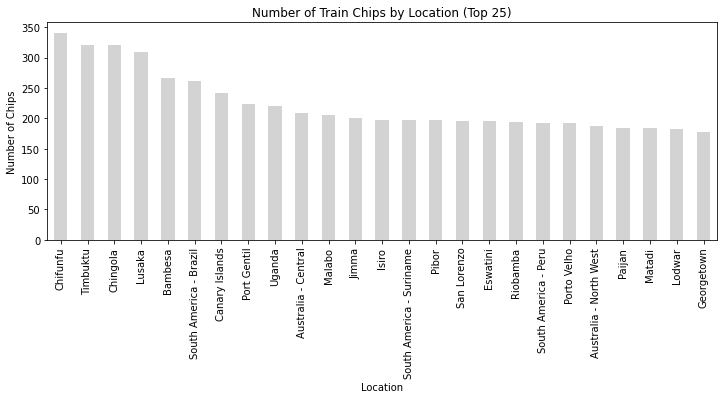

In [5]:
train_location_counts = (
    train_meta.groupby("location")["chip_id"].nunique().sort_values(ascending=False)
)

plt.figure(figsize=(12, 4))
train_location_counts.head(25).plot(kind="bar", color="lightgray")
plt.xticks(rotation=90)
plt.xlabel("Location")
plt.ylabel("Number of Chips")
plt.title("Number of Train Chips by Location (Top 25)")
plt.show()


In [7]:
train_meta["datetime"] = pd.to_datetime(train_meta["datetime"])
train_meta["year"] = train_meta.datetime.dt.year
train_meta.groupby("year")[["chip_id"]].nunique().sort_index().rename(
    columns={"chip_id": "chip_count"}
)


,chip_count
year,
2018,326
2019,1015
2020,10407


In [8]:
train_meta["datetime"].min(), train_meta["datetime"].max()

(Timestamp('2018-03-07 08:46:02+0000', tz='UTC'),
 Timestamp('2020-09-14 08:28:49+0000', tz='UTC'))

In [9]:
chips_per_locationtime = (
    train_meta.groupby(["location", "datetime"])[["chip_id"]]
    .nunique()
    .sort_values(by="chip_id", ascending=False)
    .rename(columns={"chip_id": "chip_count"})
)
chips_per_locationtime.head(10)

,,chip_count
location,datetime,
South America - Brazil,2020-09-06 15:02:37+00:00,261
Port Gentil,2020-09-08 09:50:58+00:00,223
Uganda,2019-04-25 08:29:37+00:00,220
Australia - Central,2020-08-11 01:24:00+00:00,209
Malabo,2020-09-06 10:00:03+00:00,206
Jimma,2020-05-31 08:07:58+00:00,201
Chifunfu,2020-04-29 08:20:47+00:00,197
South America - Suriname,2020-06-03 14:11:18+00:00,197
Isiro,2020-08-28 08:39:29+00:00,197


In [10]:
import rasterio

example_chip = train_meta[train_meta["chip_id"] == "pbyl"]

display(example_chip)

,chip_id,location,datetime,cloudpath,B02_path,B03_path,B04_path,B08_path,label_path,year
6571,pbyl,Lodwar,2020-09-08 08:09:15+00:00,az://./train_features/pbyl,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,/pscratch/sd/g/gstein/machine_learning/cloud-s...,2020


In [11]:
example_chip = example_chip.iloc[0]
with rasterio.open(example_chip["B04_path"]) as img:
    chip_metadata = img.meta
    img_array = img.read(1)

chip_metadata

{'driver': 'GTiff',
 'dtype': 'uint16',
 'nodata': 0.0,
 'width': 512,
 'height': 512,
 'count': 1,
 'crs': CRS.from_epsg(32636),
 'transform': Affine(10.0, 0.0, 771935.0,
        0.0, -10.0, 331300.0)}

In [65]:
%%file chip_vis.py
"""Read and visualize a single chip."""

import os
import numpy as np
import rasterio
from rasterio.errors import RasterioIOError
import rioxarray
import xrspatial.multispectral as ms
import matplotlib.pyplot as plt
from pathlib import Path

# from . import metrics
import metrics

BANDS = ['B02', 'B03', 'B04', 'B08']
NPIX = 512

def intersection_and_union(pred, true, pcut=0.5):
    """                                                                                         
    Calculates intersection and union for an image.                                             
    Args:                                                                                       
        pred (np.array): an array predictions                                                   
        true (torc.Tensor): a tensor of labels                                                  
    Returns:                                                                                    
        intersection (int): total intersection of pixels                                        
        union (int): total union of pixels                                                      
    """

    # Intersection and union totals                                                             
    pred_flattened = ((pred > 0.5) * 1).flatten()
    true_flattened = true.flatten()

    intersection = np.logical_and(true_flattened, pred_flattened)/pred_flattened.shape[0]
    union = np.logical_or(true_flattened, pred_flattened)/pred_flattened.shape[0]

    return float(np.sum(intersection)), float(np.sum(union))

class ImageChip():
    """Image data from multiple bands on a single chip."""

    def __init__(self, chip: str, bands, data_dir: os.PathLike, prediction_dir: None or os.PathLike, label_dir=None, feature_dir=None,
                 load_features: bool=True, load_labels: bool=True, load_prediction: bool=False):
        """Read in the features and labels for a single chip."""
        self.chip = chip
        self.bands = bands
        if feature_dir is None:
            self.feature_dir = data_dir/'train_features'
        else:
            self.feature_dir = feature_dir
        if label_dir is None:
            self.label_dir = data_dir/'train_labels'
        else:
            self.label_dir = label_dir    
            
        self.prediction_dir = prediction_dir
        
        band_to_ind = {k: v for v, k in enumerate(bands)}
            
        self.meta = dict({})
        self.bounds = dict({})

        self.image_array = None
        self.labels = None
        self.preds = None
        if load_features:
            # self.image_array = np.zeros((NPIX, NPIX, len(BANDS)), dtype=np.uint16)
            self.image_array = np.zeros((NPIX, NPIX, len(self.bands)), dtype=np.float32)
            
            for iband, band in enumerate(self.bands):
                try:
                    image, meta, bounds = self.load_features(band)
                except RasterioIOError:
                    self.image_array[..., iband] = None
                    self.meta[band] = None
                    self.bounds[band] = None
                else:
                    self.image_array[..., iband] = image
                    self.meta[band] = meta
                    self.bounds[band] = bounds

        if load_labels:
            try:
                image, meta, bounds = self.load_labels()
            except RasterioIOError:
                self.labels = None
            else:
                self.labels = image

        if load_prediction and prediction_dir is not None:
            try:
                image, meta, bounds = self.load_prediction()
            except RasterioIOError:
                self.preds = None
            else:
                self.preds = image
            
    def load_features(self, band: str) -> tuple:
        """Read in features."""
        try:
            feature_path = self.feature_dir/self.chip/f'{band}.tif'
            im = read_geotiff(feature_path)
        except:
            feature_path = Path("../data/train_features_new")/self.chip/f'{band}.tif'
            print(feature_path)
            im = read_geotiff(feature_path)
        return im

    def load_labels(self) -> tuple:
        """Read in labels."""
        label_path = self.label_dir/f'{self.chip}.tif'
        return read_geotiff(label_path)

    def load_prediction(self) -> tuple:
        """Read in predictions."""
        label_path = self.prediction_dir/f'{self.chip}.tif'
        return read_geotiff(label_path)

    def plot_true_colour(self, c=10.0, th=0.125) -> plt.figure:
        """Make a true-colour plot of the features."""
        nx = 1
        if self.labels is not None:
            nx += 1
        if self.preds is not None:
            nx += 1
            
        fig, ax = plt.subplots(1, nx, figsize=(nx*4, 4),
                               sharex=True, sharey=True, squeeze=False)

        # True color
        ax[0, 0].imshow(self.true_colour(c=c, th=th))
        ax[0, 0].set_title(f"chip: {self.chip}")
        
        # Label panel
        if self.labels is not None:
            ax[0, 1].imshow(self.labels, vmin=0, vmax=1, interpolation='none')
            ax[0, 1].set_title(f"True label")
            
        # Prediction panel
        if self.preds is not None:
            pred_title_string = "Pred"
            if self.labels is not None:
                self.intersection, self.union = intersection_and_union(self.preds, self.labels)
                self.IoU = self.intersection/self.union
                pred_title_string += f": Int.={self.intersection:.2f}, Un.={self.union:.2f}, IoU={self.IoU:.3f}"
                
            ax[0, 2].imshow(self.preds, vmin=0, vmax=1, interpolation='none')
            ax[0, 2].set_title(pred_title_string)
            
        fig.subplots_adjust(hspace=0, wspace=0)
        
        return fig

    def plot_all_bands(self) -> plt.figure:
        """Plot the features."""
        nx = len(self.bands)+2
        fig, ax = plt.subplots(1, nx, figsize=(nx*4, 4), sharex=True, sharey=True)
        ax[0].imshow(self.true_colour())
        ax[1].imshow(self.labels)
        for i in range(len(self.bands)):
            ax[i+2].imshow(self.image_array[..., i])
            ax[i+2].set_title(self.bands[i])
        fig.subplots_adjust(hspace=0, wspace=0)
        return fig

    def true_colour(self, c=10.0, th=0.125) -> np.array:
        """Get the true-colour representation of the chip."""
        chipdir = self.feature_dir/self.chip
        red = rioxarray.open_rasterio(chipdir/"B04.tif").squeeze()
        green = rioxarray.open_rasterio(chipdir/"B03.tif").squeeze()
        blue = rioxarray.open_rasterio(chipdir/"B02.tif").squeeze()

        return ms.true_color(r=red, g=green, b=blue, c=c, th=th)

def read_geotiff(filepath: str) -> tuple:
    """Read an image, along with metadata and bounds, from geotiff."""
    with rasterio.open(filepath) as f:
        meta = f.meta
        bounds = f.bounds
        image = f.read(1)
    return image, meta, bounds

Overwriting chip_vis.py


../data/train_features_new/adwp/B11.tif


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


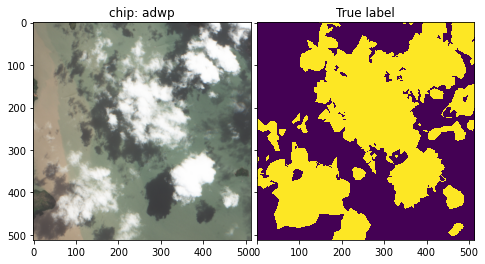

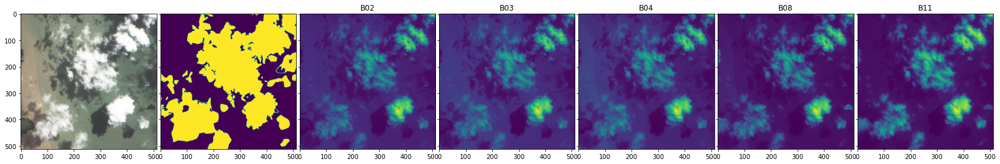

In [66]:
import chip_vis 
import metrics

nplt = 1
istart = 0
load_features = True
load_labels = True
load_prediction = True


for iplt in range(istart, istart+nplt):

    chip_id = train_meta.iloc[iplt].chip_id

    chip = chip_vis.ImageChip(chip_id, BANDS_USE,
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    
    chip.plot_true_colour(c=10, th=0.125) 
    chip.plot_all_bands()

In [49]:
def index_to_chip_string(index, nchars_per_string=4):

    nchars_in_alphabet = 26

    ind_char_start = 65
    ind_chat_end = 91

    chip_string = ''
    for i in range(nchars_per_string-1, -1, -1):
        chip_string += chr(ind_char_start+(index//nchars_in_alphabet**i)%nchars_in_alphabet)
    
    return chip_string

nsamp = 1
chip_strings=[]
for i in range(nsamp):
    string_i = index_to_chip_string(i, nchars_per_string=4)
    print(string_i)

AAAA


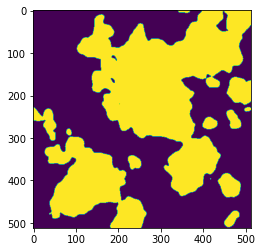

In [10]:
label = get_array("../trained_models/submission_dir/predictions/adwp.tif")
plt.imshow(label)

../data/cloudless_newlocations/all_chunks/AAAF_0050
<xarray.DataArray 'true_color' ()>
array(56, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0051
<xarray.DataArray 'true_color' ()>
array(56, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0052


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  war

<xarray.DataArray 'true_color' ()>
array(56, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0053
<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0054
<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0055


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  war

<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0056
<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0057
<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0058


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  war

<xarray.DataArray 'true_color' ()>
array(0, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)
../data/cloudless_newlocations/all_chunks/AAAF_0059
<xarray.DataArray 'true_color' ()>
array(56, dtype=uint8) <xarray.DataArray 'true_color' ()>
array(255, dtype=uint8)


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))


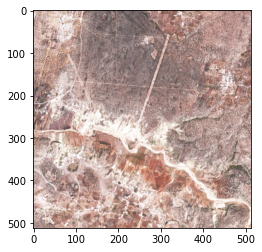

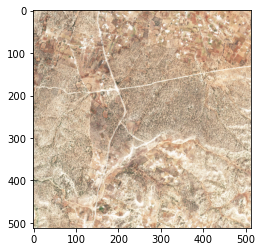

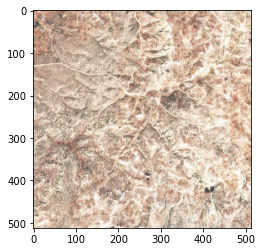

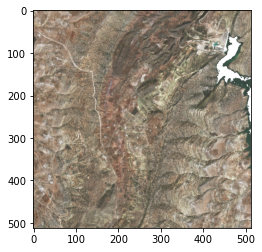

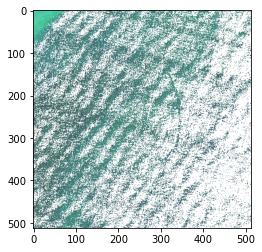

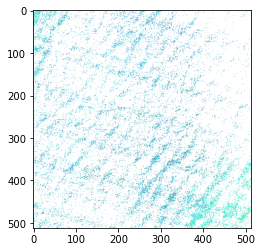

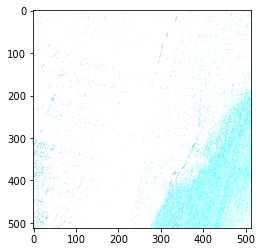

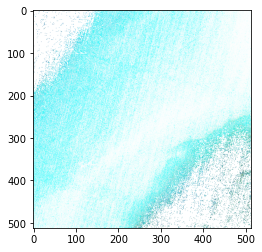

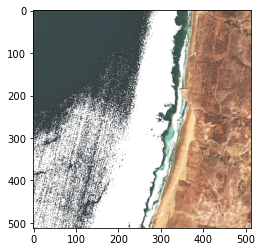

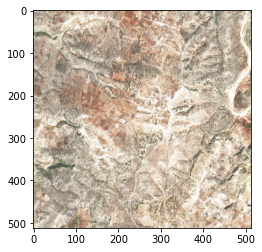

In [102]:
import os
import numpy as np
import rasterio
from rasterio.errors import RasterioIOError
import rioxarray
import xrspatial.multispectral as ms
import matplotlib.pyplot as plt

def true_colour(chipdir, c=10.0, th=0.125) -> np.array:
    """Get the true-colour representation of the chip."""
    red = rioxarray.open_rasterio(os.path.join(chipdir,"B04.tif")).squeeze()
    green = rioxarray.open_rasterio(os.path.join(chipdir,"B03.tif")).squeeze()
    blue = rioxarray.open_rasterio(os.path.join(chipdir,"B02.tif")).squeeze()

    return ms.true_color(r=red, g=green, b=blue, c=c, th=th)

chips_new = sorted(glob.glob("../data/cloudless_newlocations/all_chunks/*"))
for chip_dir in chips_new[500:510]:
    print(chip_dir)
# chip_dir = "../data/cloudless_newlocations/AACU/"
    im = true_colour(chip_dir)
    # print(chip_dir)
    # im = get_array(chip_dir+"/B04.tif")
    print(im.min(), im.max())
    plt.figure(figsize=(4,4))
    plt.imshow(im)

# im = get_array("../data/train_features/adwp/B02.tif") 
# plt.figure()
# plt.imshow(im)


In [39]:
lat, lon = np.loadtxt("../data/interesting_places/lat_long.txt", unpack=True, delimiter=',')
print(lat[:2], lon[:2])
dlat = 0.1
dlon = 0.1

[30.11904124 30.33557811] [31.22307972 32.38160492]


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


NameError: name 'im' is not defined

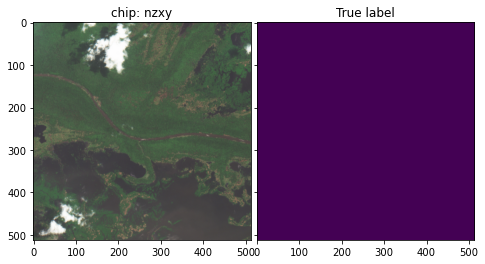

In [35]:
import chip_vis 
import metrics

nplt = 1
istart = 9500
load_features = True
load_labels = True
load_prediction = True

# images_

    # ``normalized_pixel = 1 / (1 + np.exp(c * (th - normalized_pixel)))``

# cloud_cover_frac = np.load('data/cloud_cover_fractions.npy')
for iplt in range(istart, istart+nplt):
    # if cloud_cover_frac[iplt] == 1:
    #     continue
    chip_id = train_meta.iloc[iplt].chip_id
    chip_id = 'nzxy'
    # train_meta.iloc[iplt].chip_id
    # chip_id = 'ahfi'
    # chip_id = 'ahwr'
    chip = chip_vis.ImageChip(chip_id, BANDS_USE,
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    
    
    if np.mean(chip.labels) < 2.0:
        chip.plot_true_colour(c=10, th=0.125) # 10, 1.25 #(20.0, 0.075)
   
        file = f"../data/train_features_new/{chip.chip}/SCL.tif"

        lc_classes = ['nodata',
               'water',
               'trees',
               'grass',
               'flooded veg',
               'crops',
               'scrub',
               'built area',
               'bare',
               'snow/ice',
               'clouds']

#         scl_classes = 0	NO_DATA
# 1	SATURATED_OR_DEFECTIVE
# 2	DARK_AREA_PIXELS
# 3	CLOUD_SHADOWS
# 4	VEGETATION
# 5	NOT_VEGETATED
# 6	WATER
# 7	UNCLASSIFIED
# 8	CLOUD_MEDIUM_PROBABILITY
# 9	CLOUD_HIGH_PROBABILITY
# 10	THIN_CIRRUS
# 11	SNOW
        scl, _, _ = chip_vis.read_geotiff(file)
        scl_cloud = np.zeros_like(scl, dtype=np.uint8)
        
        scl_cloud_mask = (scl == 8) | (scl == 9) | (scl == 10)
        scl_cloud[scl_cloud_mask] = 1
        
        print(im.shape)
        fig, ax = plt.subplots(1, 3, figsize=(12, 4), sharex=True, sharey=True)
        ax[0].imshow(chip.labels, interpolation="none", vmin=0, vmax=1)
        ax[1].imshow(scl_cloud, interpolation="none", vmin=0, vmax=1)
        cb = ax[2].imshow(scl, interpolation="none", cmap=plt.cm.tab10)#, vmin=0.5, vmax=9.5, 
        plt.colorbar(cb)

/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  warnings.warn(str(rio_warning.message), type(rio_warning.message))
/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rioxarray/_io.py:841: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  

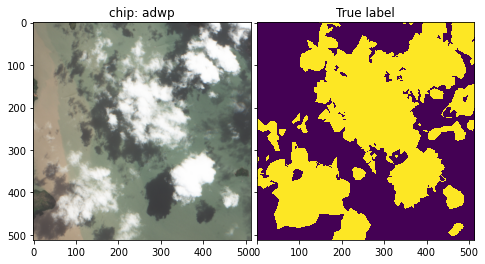

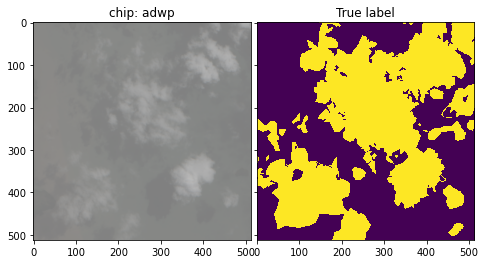

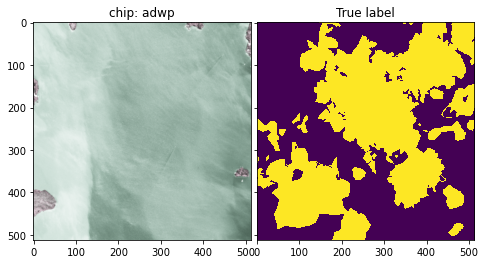

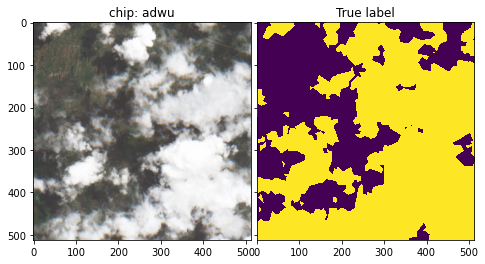

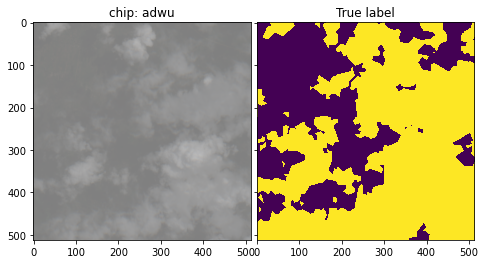

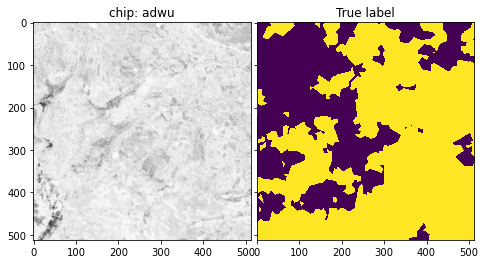

In [11]:
import chip_vis
import metrics

nplt = 2
load_features = True
load_labels = True
load_prediction = True

# images_

    # ``normalized_pixel = 1 / (1 + np.exp(c * (th - normalized_pixel)))``

# cloud_cover_frac = np.load('data/cloud_cover_fractions.npy')
for iplt in range(nplt):
    # if cloud_cover_frac[iplt] == 1:
    #     continue
    chip_id = train_meta.iloc[iplt].chip_id
    # train_meta.iloc[iplt].chip_id
    # chip_id = 'ahfi'
    # chip_id = 'ahwr'
    load_labels = True
    chip = chip_vis.ImageChip(chip_id, 
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    chip.plot_true_colour(c=10, th=0.125) # 10, 1.25 #(20.0, 0.075)
    
    chip = chip_vis.ImageChip(chip_id, 
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    chip.plot_true_colour(c=1, th=0) # 10, 1.25 #(20.0, 0.075)
    
       
    chip = chip_vis.ImageChip(chip_id, 
                             DATA_DIR,PREDICTION_DIR,
                             feature_dir=DATA_DIR_CLOUDLESS_MOST_SIMILAR,
                            load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    chip.plot_true_colour(c=10, th=0.125) # 10, 1.25 #(20.0, 0.075)
    

In [29]:
data = np.load("../data/cloudless/adwp/B06.npz")
print(data.files)
data['images'].shape

['images', 'times', 'dtimes', 'properties']


(5, 512, 512)

(512, 512)


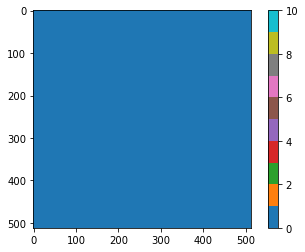

In [55]:
# file = "../data/train_features_new/adwp/LC.tif"
file = "../data/train_features_new/dvve/LC.tif"

lc_classes = ['nodata',
       'water',
       'trees',
       'grass',
       'flooded veg',
       'crops',
       'scrub',
       'built area',
       'bare',
       'snow/ice',
       'clouds']

im, _, _ = chip_vis.read_geotiff(file)
print(im.shape)
plt.imshow(im, vmin=0, vmax=10, cmap=plt.cm.tab10, interpolation="None")
plt.colorbar()

-rw-rw---- 1 gstein 72570  262266 Jan 21 18:15 ../data/clouds/adwp/opacity.tif
-rw-rw---- 1 gstein 72570 1048710 Jan 21 18:15 ../data/clouds/adwp/label.tif
-rw-rw---- 1 gstein 72570 1048710 Jan 21 18:15 ../data/clouds/adwp/B08.tif
-rw-rw---- 1 gstein 72570 1048710 Jan 21 18:15 ../data/clouds/adwp/B04.tif
-rw-rw---- 1 gstein 72570 1048710 Jan 21 18:15 ../data/clouds/adwp/B03.tif
-rw-rw---- 1 gstein 72570 1048710 Jan 21 18:15 ../data/clouds/adwp/B02.tif


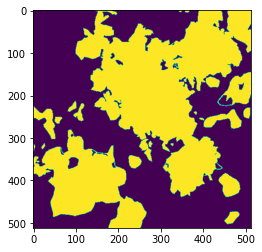

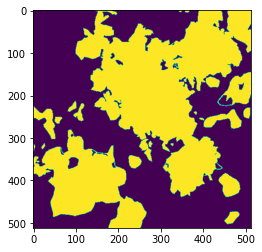

In [131]:
arr0 = get_array("../data/train_labels/adwp.tif")
arr1 = get_array("../data/clouds/adwp/label.tif")

plt.imshow(arr0)
plt.figure()
plt.imshow(arr1)

!ls -rlt ../data/clouds/adwp/*

0


/global/homes/g/gstein/.conda/envs/cloud-seg/lib/python3.9/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


float32
[522. 648. 556. 534.] [9600. 9312. 8928. 8488.]
float32
-2535.671 9600.0 -1618.457 9600.0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
float32
[ 436.  534.  456. 1016.] [7208. 7044. 6776. 7248.]
float32
-4099.335 7248.0 -1681.6365 8861.511
16
float32
[ 488.  602.  543. 1048.] [5284. 5260. 5092. 5908.]
float32
-2728.7148 5908.0 -431.31226 6486.4795
17


/tmp/ipykernel_147206/285572282.py:230: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,2,figsize=(8,4))


float32
[ 455.  557.  487. 1002.] [6968. 6792. 6528. 6992.]
float32
-2434.0542 6992.0 -1697.4679 6992.0
18
float32
[716. 684. 622. 576.] [3714. 3542. 3376. 3168.]
float32
-290.68256 2773.0554 -3.1421509 3181.0554
19


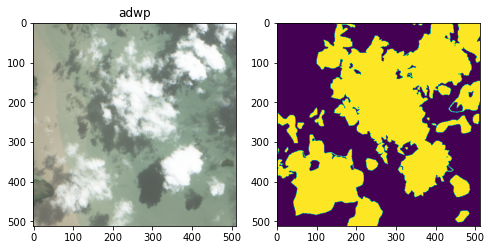

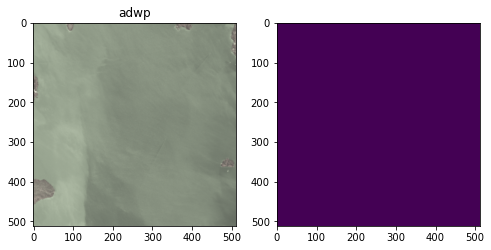

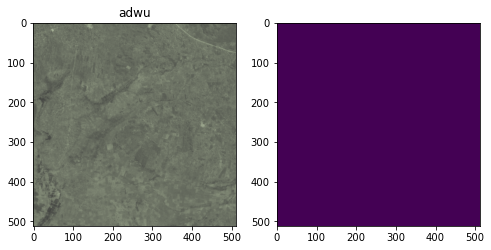

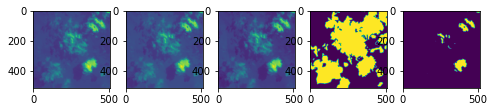

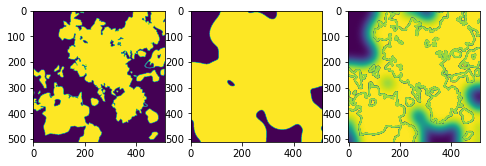

...

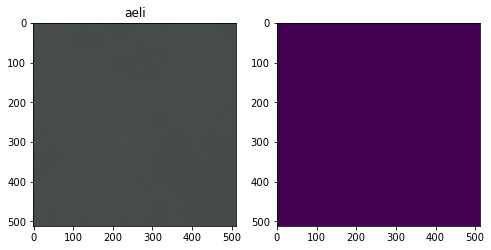

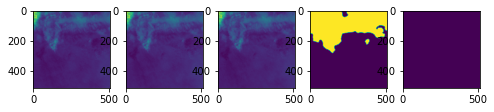

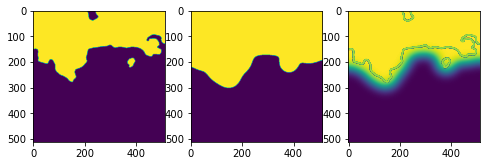

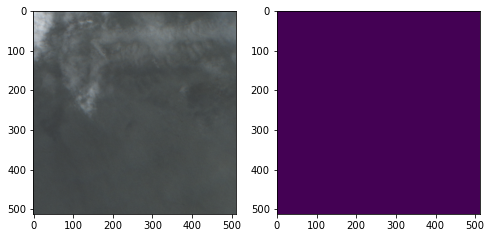

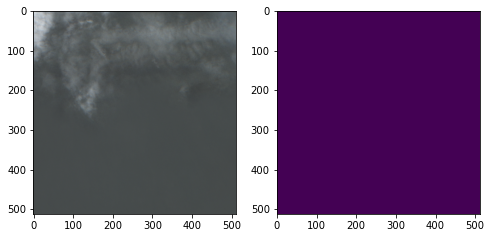

In [7]:
# def _true_color_numpy(r, g, b, nodata, c, th):
#     a = np.where(np.logical_or(np.isnan(r), r <= nodata), 0, 255)

#     h, w = r.shape
#     out = np.zeros((h, w, 4), dtype=np.uint8)

#     pixel_max = 255
#     out[:, :, 0] = (_normalize_data(r, pixel_max, c, th)).astype(np.uint8)
#     out[:, :, 1] = (_normalize_data(g, pixel_max, c, th)).astype(np.uint8)
#     out[:, :, 2] = (_normalize_data(b, pixel_max, c, th)).astype(np.uint8)
#     out[:, :, 3] = a.astype(np.uint8)
#     return out

# def _normalize_data(agg, pixel_max, c, th):
#     mapper = ArrayTypeFunctionMapping(numpy_func=_normalize_data_numpy,
#                                       dask_func=_normalize_data_dask,
#                                       cupy_func=_normalize_data_cupy,
#                                       dask_cupy_func=_normalize_data_dask_cupy)
#     out = mapper(agg)(agg.data, pixel_max, c, th)
#     return out

# def _normalize_data_numpy(data, pixel_max, c, th):
#     min_val = np.nanmin(data)
#     max_val = np.nanmax(data)
#     out = _normalize_data_cpu(
#         data, min_val, max_val, pixel_max, c, th
#     )
#     return out

# def _normalize_data_cpu(data, min_val, max_val, pixel_max, c, th):
#     out = np.full(data.shape, np.nan, dtype=np.float32)

#     range_val = max_val - min_val
#     rows, cols = data.shape

#     # check range_val to avoid dividing by zero
#     if range_val != 0:
#         for y in range(rows):
#             for x in range(cols):
#                 val = data[y, x]
#                 norm = (val - min_val) / range_val
#                 # sigmoid contrast enhancement
#                 norm = 1 / (1 + np.exp(c * (th - norm)))
#                 out[y, x] = norm * pixel_max
#     return out


def true_color_band(band_data, nodata=1, pixel_max=255, c=10., th=0.125):
    """
    Normalize band with:    
    min_val = np.nanmin(data)
    max_val = np.nanmax(data)
    range_val = max_val - min_val
    
    out = (data.astype(np.float32) - min_val)/range_val
    out = 1. / (1. + np.exp(c * (th - out)))
    
    Copied from https://xarray-spatial.org/_modules/xrspatial/multispectral.html#true_color
    """
    # a = np.where(np.logical_or(np.isnan(r), r <= nodata), 0, 255)
    pixel_max = 255

    # h, w = band_data.shape
    # out = np.zeros((h, w, 4), dtype=np.uint8)
    # out[:, :, 0] = (normalize_data_numpy(r, pixel_max, c, th)).astype(np.uint8)
    # out[:, :, 1] = (normalize_data_numpy(g, pixel_max, c, th)).astype(np.uint8)
    # out[:, :, 2] = (normalize_data_numpy(b, pixel_max, c, th)).astype(np.uint8)
    
    out = normalize_data_xrspatial(band_data, pixel_max, c, th) #).astype(np.uint8)

    return out

def normalize_data_xrspatial(data, pixel_max, c, th):
    """
    Copied from https://xarray-spatial.org/_modules/xrspatial/multispectral.html#true_color
    """
    # min_val = np.nanmin(data)
    # max_val = np.nanmax(data)
    min_val = 0
    max_val = 10000
    data = np.clip(data, min_val, max_val)
    
    range_val = max_val - min_val
    out = (data.astype(np.float32) - min_val)/range_val
    out = 1. / (1. + np.exp(c * (th - out)))
    
    return out * pixel_max


from scipy.ndimage import gaussian_filter


nplt = 20
istart = 0
load_features = True
load_labels = True
load_prediction = True

# images_

    # ``normalized_pixel = 1 / (1 + np.exp(c * (th - normalized_pixel)))``

# cloud_cover_frac = np.load('data/cloud_cover_fractions.npy')
for iplt in range(istart, istart+nplt):
    print(iplt)
    # if cloud_cover_frac[iplt] == 1:
    #     continue
    chip_id = train_meta.iloc[iplt].chip_id
    # train_meta.iloc[iplt].chip_id
    # chip_id = 'ahfi'
    # chip_id = 'ahwr'
    load_labels = True
    chip = chip_vis.ImageChip(chip_id, 
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    if np.mean(chip.labels) > 0.5:
        continue
    r = true_color_band(chip.image_array[..., 2])
    g = true_color_band(chip.image_array[..., 1])
    b = true_color_band(chip.image_array[..., 0])

    im = np.stack([r,g,b], axis=-1).astype(np.uint8)

    fig, ax = plt.subplots(1,2,figsize=(8,4))
    ax[0].set_title(chip_id)
    ax[0].imshow(im)
    ax[1].imshow(chip.labels, vmin=0, vmax=1)   
  
    for iiplt in range(2):

        chip_id = train_meta.iloc[iplt+iiplt].chip_id
        # else:
            # chip_id = train_meta.sample(n=1, random_state=iplt).chip_id

        # cloudless
        chip_cloudless = chip_vis.ImageChip(chip_id, 
                                 DATA_DIR,PREDICTION_DIR,
                                 feature_dir=DATA_DIR_CLOUDLESS_MOST_SIMILAR,
                                load_features=load_features, 
                                  load_prediction=load_prediction,
                                 load_labels=load_labels)

        r = true_color_band(chip_cloudless.image_array[..., 2])
        g = true_color_band(chip_cloudless.image_array[..., 1])
        b = true_color_band(chip_cloudless.image_array[..., 0])

        im = np.stack([r,g,b], axis=-1).astype(np.uint8)

        fig, ax = plt.subplots(1,2,figsize=(8,4))
        ax[0].set_title(chip_id)
        ax[0].imshow(im)
        ax[1].imshow(chip_cloudless.labels*0, vmin=0, vmax=1)   
    
    chip_id = train_meta.iloc[iplt].chip_id
    
     # clouds
    chip_clouds = chip_vis.ImageChip(chip_id, 
                             DATA_DIR,PREDICTION_DIR,
                             feature_dir=DATA_DIR_CLOUDS,
                            load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    print(chip_clouds.image_array.dtype)

    cloud_opacity = get_array(DATA_DIR_CLOUDS/ f"{chip_id}" / "opacity.tif")
    fig, ax = plt.subplots(1,5,figsize=(8,4))
    ax[0].imshow(chip_clouds.image_array[..., 0])
    ax[1].imshow(chip_clouds.image_array[..., 1])
    ax[2].imshow(chip_clouds.image_array[..., 2])
    ax[3].imshow(get_array(DATA_DIR_CLOUDS/ f"{chip_id}" / "label.tif"))
    ax[4].imshow(cloud_opacity)

    r = true_color_band(chip_clouds.image_array[..., 2])
    g = true_color_band(chip_clouds.image_array[..., 1])
    b = true_color_band(chip_clouds.image_array[..., 0])

    im = np.stack([r,g,b], axis=-1).astype(np.uint8)

    #smooth label
    labels = chip.labels
    
    labels_wide = gaussian_filter(chip.labels.astype(np.float32), sigma=20)
    labels_wide = ((labels_wide > 0.05)*1).astype(np.uint8)
    
    labels_smooth = gaussian_filter(labels_wide.astype(np.float32), sigma=20)
    
    fig, ax = plt.subplots(1,3,figsize=(8,4))
    ax[0].imshow(labels)
    ax[1].imshow(labels_wide)
    ax[2].imshow(labels_smooth)
    ax[2].contour(labels)
       
    # fig, ax = plt.subplots(1,2,figsize=(8,4))
    # ax[0].imshow(im*labels_smooth[..., None])
    # ax[1].imshow(chip_clouds.labels, vmin=0, vmax=1)   
    
    print(np.min(chip.image_array, axis=(0,1)), np.max(chip.image_array, axis=(0,1)))
    
    
    # First term is copy paste, second is additive
    
    # Add everywhere
    new_cloud_chip = ((chip_clouds.image_array * cloud_opacity[..., None])
                                     + (chip_cloudless.image_array + chip_clouds.image_array) * (1-cloud_opacity[..., None]))
    
    print(chip_clouds.image_array.dtype)
    print(chip_clouds.image_array.min(), chip_clouds.image_array.max(), new_cloud_chip.min(), new_cloud_chip.max())
    r = true_color_band(new_cloud_chip[..., 2])
    g = true_color_band(new_cloud_chip[..., 1])
    b = true_color_band(new_cloud_chip[..., 0])

    im = np.stack([r,g,b], axis=-1).astype(np.uint8)

    fig, ax = plt.subplots(1,2,figsize=(8,4))
    ax[0].imshow(im)
    ax[1].imshow(chip.labels*0, vmin=0, vmax=1)   
    
    # Only add where label==1
    new_cloud_chip = ((chip_clouds.image_array * cloud_opacity[..., None])
                                     + (chip_cloudless.image_array + chip_clouds.image_array * labels_smooth[..., None]) * (1-cloud_opacity[..., None]))
    
    r = true_color_band(new_cloud_chip[..., 2])
    g = true_color_band(new_cloud_chip[..., 1])
    b = true_color_band(new_cloud_chip[..., 0])

    im = np.stack([r,g,b], axis=-1).astype(np.uint8)

    fig, ax = plt.subplots(1,2,figsize=(8,4))
    ax[0].imshow(im)
    ax[1].imshow(chip.labels*0, vmin=0, vmax=1)   
    

In [64]:
cs = [10,15,20,25]
ths = [0.075, 0.1, 0.125]
cmin, thmin = 15.894736842105262, 0.08684210526315789

# cs = np.linspace(5, 20, 20)
# ths = np.linspace(0.075, 0.125, 20)

# cs = np.linspace(cmin-2, cmin+2, 20)
# ths = np.linspace(thmin-0.1, thmin+0, 20)

std_diff_min = 1e9
for c in cs:
    for th in ths:
        # chip.plot_true_colour(c=c, th=th) # 10, 1.25
        im_tc = chip.true_colour(c=c, th=th)[:, :, :3].to_numpy()
        # plt.imshow(im_visual)

        im_diff = (im_tc.astype(np.float32) - im_visual.astype(np.float32))
        
        # print(np.mean(im_tc, axis=(0,1)), np.max(im_tc, axis=(0,1)), np.min(im_tc, axis=(0,1)))
        # print(np.mean(im_visual, axis=(0,1)), np.max(im_visual, axis=(0,1)), np.min(im_visual, axis=(0,1)))
        # print(c, th, np.mean(im_diff, axis=(0,1)), np.max(im_diff, axis=(0,1)), np.min(im_diff, axis=(0,1)), np.std(im_diff[..., ichan]))
        std_diff = np.std(im_diff[..., ichan])
        if std_diff < std_diff_min:
            std_diff_min = std_diff
            c_min = c
            th_min = th
        print(c, th, std_diff)


#         fig, ax = plt.subplots(1, 3, figsize=(12, 12),
#                                sharex=True, sharey=True, squeeze=False)
        
#         for ichan in range(3):
# #             ax[0, ichan].imshow(im_tc[..., ichan], vmin=-0, vmax=255)

# #             ax[1, ichan].imshow(im_visual[..., ichan], vmin=0, vmax=255)

#             ax[0, ichan].set_title(f"c={c}, th={th}, std={np.std(im_diff[..., ichan])}")

#             ax[0, ichan].imshow(im_diff[..., ichan], vmin=-255, vmax=255)


NameError: name 'im_visual' is not defined

In [12]:
import pyproj

def lat_long_bounds(chip):
    """Given the path to a GeoTIFF, returns the image bounds in latitude and
    longitude coordinates.

    Returns points as a tuple of (left, bottom, right, top)
    """
    print(chip)
    # create a converter starting with the current projection
    current_crs = pyproj.CRS(chip.meta["B04"]["crs"])
    crs_transform = pyproj.Transformer.from_crs(current_crs, current_crs.geodetic_crs)

    # returns left, bottom, right, top
    return crs_transform.transform_bounds(*chip.bounds["B04"])

left, bottom, right, top = lat_long_bounds(chip)
print(
    f"Image coordinates (lat, long):\nStart: ({left}, {bottom})"
    f"\nEnd: ({right}, {top})"
)
dlat_lon = [top-bottom, right-left]
dlat_lon

Image coordinates (lat, long):
Start: (-2.4301388948872398, 32.932404223147365)
End: (-2.3838159738370943, 32.97845822290882)


[0.046053999761454634, 0.04632292105014546]

In [7]:
import glob

NUMPY_ARRAY_DIR = "../data/big_numpy_arrays/nchips_100/"
chunksize = 100

# arrays_want = ['images', 'labels', 'preds', 'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU', 'chip_ids']
# arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'B02', 'B03', 'B04', 'labels', 'preds', 'intersection', 'union'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]
arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'intersection', 'union'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]

# arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'intersection', 'union', 'B02', 'labels'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]

nchips_total = 11748
nchunks_use = 999
data = {}
for array_name in arrays_want:
    
    files = sorted(glob.glob(NUMPY_ARRAY_DIR + f"{array_name}*"))

    array_list = []
    for f_ in files[:nchunks_use]:
        array_list.append(np.load(f_))
        
    data[array_name] = np.concatenate(array_list, axis=0)
    
# bad_chips_mask = np.isin(data['chip_ids'], BAD_CHIPS)
# for k, v in data.items():
#     print(k, v.shape, v[~bad_chips_mask].shape)
#     data[k] = v[~bad_chips_mask]

BAD_CHIPS = np.loadtxt("../data/BAD_CHIP_DATA/BAD_CHIP_LABEL_IDS.txt", dtype=str)
in_bad_chips = np.isin(data['chip_ids'], BAD_CHIPS)

data['inds_orig'] = np.arange(data[arrays_want[0]].shape[0])
data['worst_preds'] = np.abs(data['intersection']-data['union'])
for k, v in data.items():
    data[k] = v[~in_bad_chips]
    print(k, data[k].shape)
    # Remove bad chips



lat (11231,)
lon (11231,)
dlat (11231,)
dlon (11231,)
chip_ids (11231,)
intersection (11231,)
union (11231,)
inds_orig (11231,)
worst_preds (11231,)


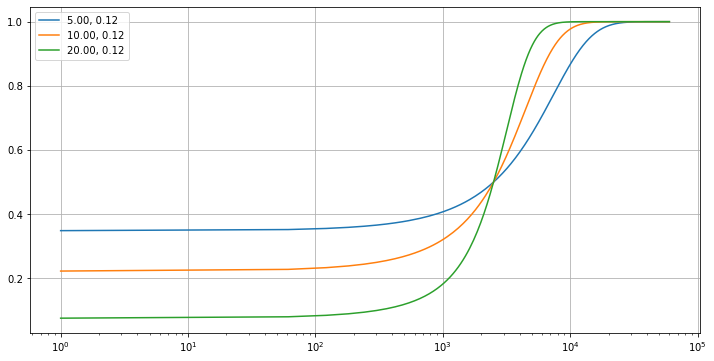

In [76]:
import numpy as np
import matplotlib.pyplot as plt

# band transformations

xx = np.linspace(1,6e4, 1000)
c = 10.
th = .125

xmin = 1.
xmax = 2.e4

xnorm = (xx-xmin)/(xmax-xmin) 

cs = [5,10,20]
ths = [0.125]#, 0.05, 0.1, 0.15, 0.2]


plt.figure(figsize=(12,6))

for c in cs:
    for th in ths:
        true_color = 1./(1+np.exp(c * (th - xnorm)))
        plt.semilogx(xx, true_color, label=f"{c:.2f}, {th:.2f}")
        # plt.loglog(xnorm, feder)
plt.legend()
plt.grid()

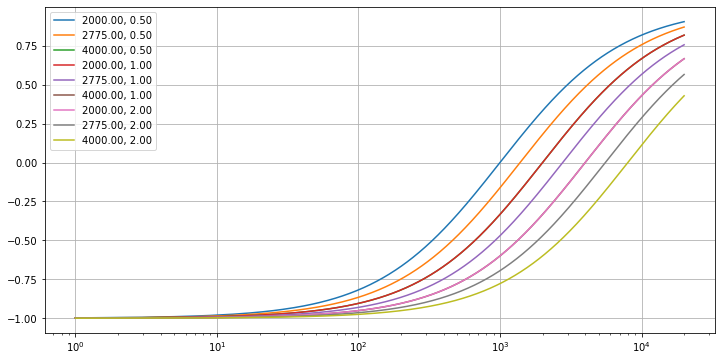

In [109]:
xx = np.linspace(1, 2e4, 10000)

def feder_scale(feature, xmean=2775., kappa=1.0, inv=False):

    if not inv:
        return 2*(feature/xmean)/((feature/xmean)+kappa) - 1

    if inv:
        return -kappa *	xmean *	(feature+1) / (feature-1)

xmin = 1.
xmax = 1.e4
xmean = 2775.
xnorm = xx/xmean

plt.figure(figsize=(12,6))
kappas = [0.5, 1.0, 2]
xmeans = [2000, 2775, 4000]
for kappa in kappas:
    for xmean in xmeans:
        
        plt.semilogx(xx, feder_scale(xx, xmean=xmean, kappa=kappa), label=f"{xmean:.2f}, {kappa:.2f}")
        
plt.grid()
plt.legend()

In [73]:
feature.mean()

2775.7184920791105

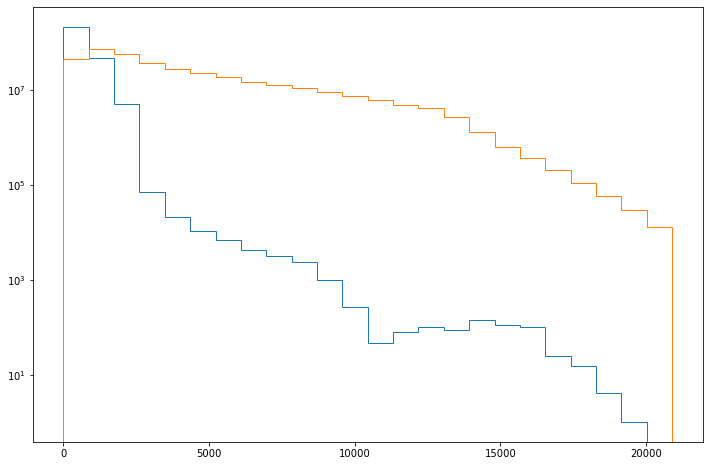

In [6]:
# Look at optimal band scalings
BAND_USE = 'B02'

feature = data[BAND_USE].flatten()
label = data['labels'].flatten()


bins = np.linspace(feature.min(), feature.max(), 25)
plt.figure(figsize=(12,8))
plt.hist(feature[label==0], bins=bins, histtype='step')
plt.hist(feature[label==1], bins=bins, histtype='step')
plt.yscale('log')



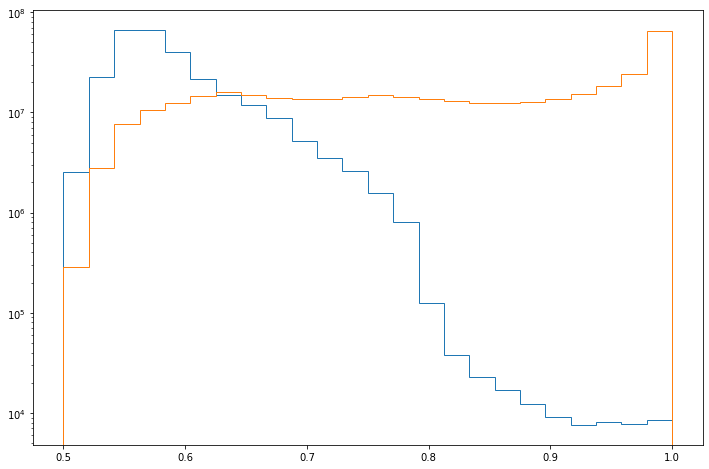

In [7]:

def true_color_scale(feature, xmin=0, xmax=1e4, c=10., th=0.):
    
    fnorm = (feature-xmin)/(xmax-xmin)

    return 1./(1+np.exp(c*(th-fnorm)))

xmin = 0.
xmax = 17500.

feature_true_color = true_color_scale(feature, xmin=xmin, xmax=xmax)
bins = np.linspace(feature_true_color.min(), feature_true_color.max(), 25)
plt.figure(figsize=(12,8))
plt.hist(feature_true_color[label==0], bins=bins, histtype='step')
plt.hist(feature_true_color[label==1], bins=bins, histtype='step')
plt.yscale('log')


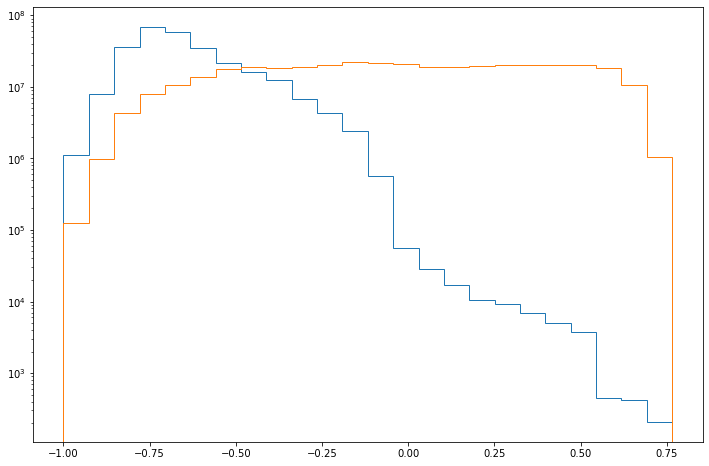

In [8]:
def feder_scale(feature, xmean=2775., kappa=1.0, inv=False):

    if not inv:
        return 2*(feature/xmean)/((feature/xmean)+kappa) - 1

    if inv:
        return -kappa *	xmean *	(feature+1) / (feature-1)



xmean = 2775. 
kappa = 1.0

feature_feder = feder_scale(feature, xmean=xmean, kappa=kappa)
bins = np.linspace(feature_feder.min(), feature_feder.max(), 25)
plt.figure(figsize=(12,8))
plt.hist(feature_feder[label==0], bins=bins, histtype='step')
plt.hist(feature_feder[label==1], bins=bins, histtype='step')
plt.yscale('log')


In [9]:
def true_color_band(band_data, nodata=1, pixel_max=255, c=10., th=0.125):
    """
    Normalize band with:    
    min_val = np.nanmin(data)
    max_val = np.nanmax(data)
    range_val = max_val - min_val
    
    out = (data.astype(np.float32) - min_val)/range_val
    out = 1. / (1. + np.exp(c * (th - out)))
    
    Copied from https://xarray-spatial.org/_modules/xrspatial/multispectral.html#true_color
    """
    # a = np.where(np.logical_or(np.isnan(r), r <= nodata), 0, 255)
    pixel_max = 255

    # h, w = band_data.shape
    # out = np.zeros((h, w, 4), dtype=np.uint8)
    # out[:, :, 0] = (normalize_data_numpy(r, pixel_max, c, th)).astype(np.uint8)
    # out[:, :, 1] = (normalize_data_numpy(g, pixel_max, c, th)).astype(np.uint8)
    # out[:, :, 2] = (normalize_data_numpy(b, pixel_max, c, th)).astype(np.uint8)
    
    out = normalize_data_xrspatial(band_data, pixel_max, c, th) #).astype(np.uint8)

    return out

def normalize_data_xrspatial(data, pixel_max, c, th):
    """
    Copied from https://xarray-spatial.org/_modules/xrspatial/multispectral.html#true_color
    """
    # min_val = np.nanmin(data)
    # max_val = np.nanmax(data)
    min_val = 0
    max_val = 10000
    data = np.clip(data, min_val, max_val)
    
    range_val = max_val - min_val
    print("MIN, MAX = ", min_val, max_val)
    out = (data.astype(np.float32) - min_val)/range_val
    out = 1. / (1. + np.exp(c * (th - out)))
    
    return out * pixel_max

# images_true_color = np.stack([
# true_color_band(data['B04']),
# true_color_band(data['B03']),
# true_color_band(data['B02']),
# ],
# axis=-1).astype(np.uint8)

# print(images_true_color.shape)
# true_color_band(data['B04']).shape                             

# labels_rgb = (np.broadcast_to(data['labels'][..., None], data['labels'].shape+(3,))*255).astype(np.uint8)
# preds_rgb = (np.broadcast_to(data['preds'][..., None], data['preds'].shape+(3,))*255).astype(np.uint8)

# labels_rgb.shape

# images_plot = np.concatenate((images_true_color, labels_rgb, preds_rgb), axis=2)
# print(images_plot.shape)


In [10]:
def load_image_and_pred_from_index(index):
    ichunk = index//chunksize
    ind_in_chunk = index % chunksize
    
    ind_start = ichunk*chunksize
    ind_end = min(nchips_total, (ichunk+1)*chunksize)
    
    B02 = np.load(NUMPY_ARRAY_DIR + f"B02_{ind_start:06}_{ind_end:06}.npy", mmap_mode='r')[ind_in_chunk]
    B03 = np.load(NUMPY_ARRAY_DIR + f"B03_{ind_start:06}_{ind_end:06}.npy", mmap_mode='r')[ind_in_chunk]
    B04 = np.load(NUMPY_ARRAY_DIR + f"B04_{ind_start:06}_{ind_end:06}.npy", mmap_mode='r')[ind_in_chunk]

    label = np.load(NUMPY_ARRAY_DIR + f"labels_{ind_start:06}_{ind_end:06}.npy", mmap_mode='r')[ind_in_chunk]
    pred = np.load(NUMPY_ARRAY_DIR + f"preds_{ind_start:06}_{ind_end:06}.npy", mmap_mode='r')[ind_in_chunk]

    image_true_color = np.stack([
        true_color_band(B04),
        true_color_band(B03),
        true_color_band(B02),
    ],
        axis=-1).astype(np.uint8)

    label_rgb = (np.broadcast_to(label[..., None], label.shape+(3,))*255).astype(np.uint8)
    pred_rgb = (np.broadcast_to(pred[..., None], pred.shape+(3,))*255).astype(np.uint8)

    print(image_true_color.shape, label_rgb.shape, pred_rgb.shape)

    image_plot = np.concatenate((image_true_color, label_rgb, pred_rgb), axis=1)

    return image_plot

im = load_image_and_pred_from_index(1)   


MIN, MAX =  0 10000
MIN, MAX =  0 10000
MIN, MAX =  0 10000
(512, 512, 3) (512, 512, 3) (512, 512, 3)


MIN, MAX =  0 10000
MIN, MAX =  0 10000
MIN, MAX =  0 10000
(512, 512, 3) (512, 512, 3) (512, 512, 3)


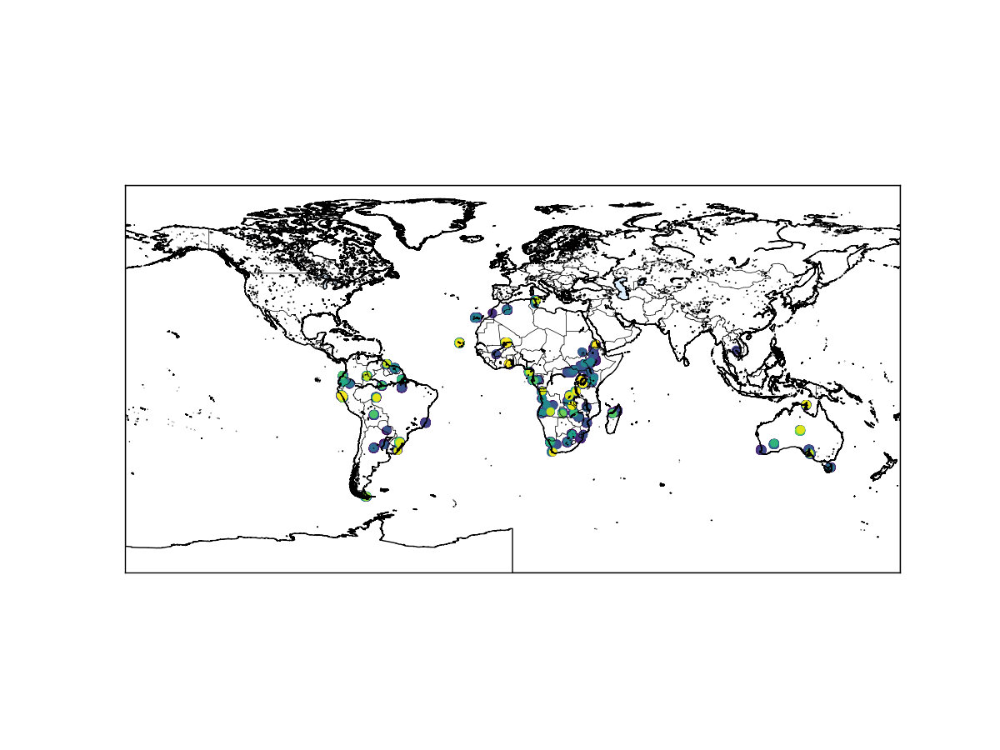

In [11]:
%matplotlib widget
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

# import geopandas as gpd

import os
os.environ["PROJ_LIB"] = "/global/homes/g/gstein/.conda/envs/cloud-seg/bin"; #fixr

from mpl_toolkits.basemap import Basemap


df = pd.DataFrame(data=np.c_[data['lat'], data['lon']],
                  columns=['lat', 'lon'])


fig, ax = plt.subplots(figsize=(12,9))

# world.plot(color="lightgrey", ax=ax)
# world.boundary.plot(color="lightgrey", ax=ax)

m = Basemap(projection='cyl', resolution='h',
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180, )
# draw_map(m)
m.fillcontinents(color="#FFFFFF", lake_color='#DDEEFF')
m.drawmapboundary()#fill_color="#DDEEFF")
m.drawcoastlines()
m.drawcountries()

line, = ax.plot(df['lon'], df['lat'], ls="", marker=".",  color='k', alpha=0.0)

inds_sort = np.argsort(data['worst_preds'])
ax.scatter(df['lon'][inds_sort], df['lat'][inds_sort], marker="o", c=data['worst_preds'][inds_sort])

# line, = ax.scatter(df['lon'], df['lat'], c=worst_preds)#ls="", marker="o",  #'orangered')



# create the annotations box
im = OffsetImage(load_image_and_pred_from_index(0)   , zoom=0.2)
xybox=(75., 75.)
im_loc = (-100, 60) 
ab = AnnotationBbox(im,
                    im_loc,
                    xybox=xybox,
                    xycoords='data',
                    boxcoords="offset points",
                    pad=0.3,
                    arrowprops=dict(arrowstyle="->"))
# add it to the axes and make it invisible
ax.add_artist(ab)
ab.set_visible(False)

def hover(event):
    # if the mouse is over the scatter points
    if line.contains(event)[0]:
        # find out the index within the array from the event
        ind, = line.contains(event)[1]["ind"]
        # get the figure size
        w,h = fig.get_size_inches()*fig.dpi
        ws = (event.x > w/2.)*-1 + (event.x <= w/2.) 
        hs = (event.y > h/2.)*-1 + (event.y <= h/2.)
        # if event occurs in the top or right quadrant of the figure,
        # change the annotation box position relative to mouse.
        ab.xybox = (xybox[0]*ws, xybox[1]*hs)
        # make annotation box visible
        ab.set_visible(True)
        
        # place it at the position of the hovered scatter point
        ab.xy =(df.iloc[ind]['lon'], df.iloc[ind]['lat'])
        
        # set the image corresponding to that point
        im.set_data(load_image_and_pred_from_index(data['inds_orig'][ind]))
        
    else:
        #if the mouse is not over a scatter point
        ab.set_visible(False)
    fig.canvas.draw_idle()

# add callback for mouse moves
fig.canvas.mpl_connect('motion_notify_event', hover)           
plt.show()

['ibeu' 'emnp' 'eojj' ... 'vsvv' 'vswa' 'fnkw']


Text(0.5, 1.0, 'worst_preds')

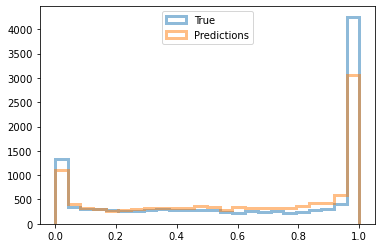

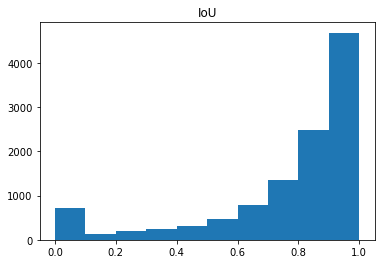

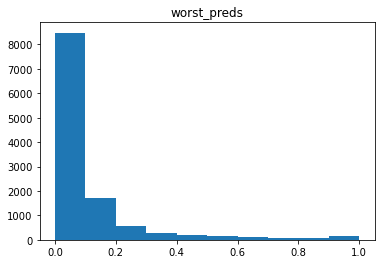

In [45]:

plt.figure()
bins = np.linspace(0,1,25)
plt.hist(data['labels_mean'], bins=bins, alpha=0.5, histtype='step', lw=3, label="True");
plt.hist(data['preds_mean'], bins=bins, alpha=0.5, histtype='step', lw=3, label="Predictions");
plt.legend(loc='upper center')

# plt.figure()
# plt.hist(data['intersection'])
# plt.title('intersection')

# plt.figure()
# plt.hist(data['union'])
# plt.title('union')

plt.figure()
plt.hist(data['IoU'])
plt.title('IoU')

worst_preds = np.abs(data['intersection']-data['union'])
# worst_preds = np.abs(data['labels_mean'] - data['preds_mean'])
inds_worst = np.argsort(worst_preds)[::-1]

print(data['chip_ids'][inds_worst])
plt.figure()
plt.hist(worst_preds)
plt.title('worst_preds')

/global/homes/g/gstein/.conda/envs/cloud_cover/lib/python3.8/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/global/homes/g/gstein/.conda/envs/cloud_cover/lib/python3.8/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/global/homes/g/gstein/.conda/envs/cloud_cover/lib/python3.8/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix be returned.
  s = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)
/global/homes/g/gstein/.conda/envs/cloud_cover/lib/python3.8/site-packages/rasterio/__init__.py:220: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matr

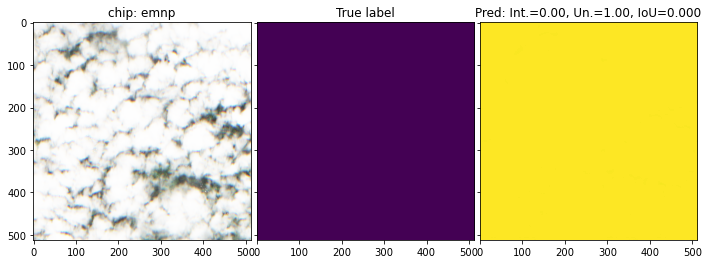

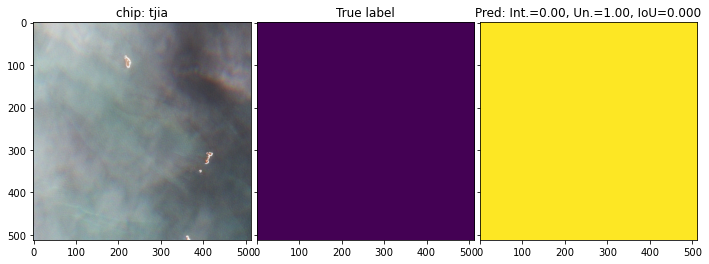

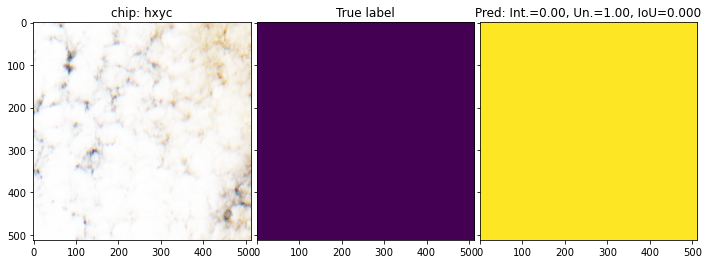

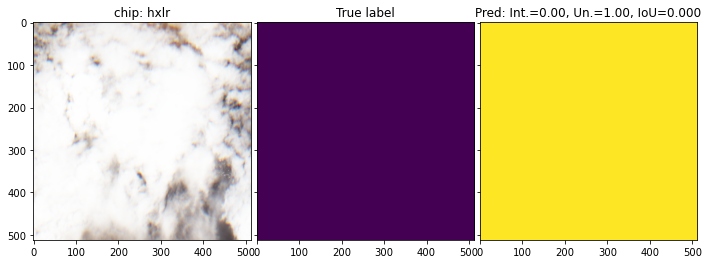

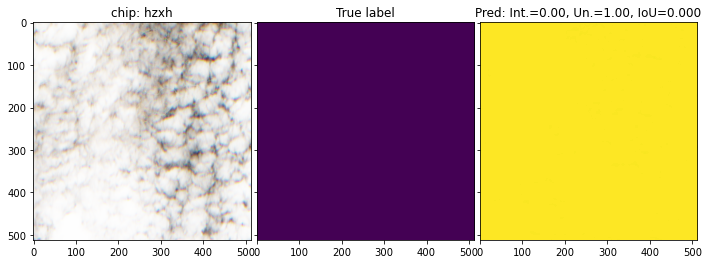

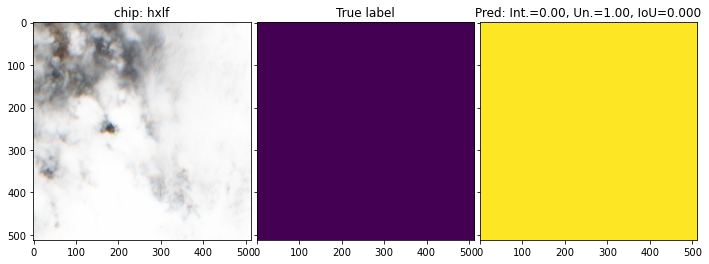

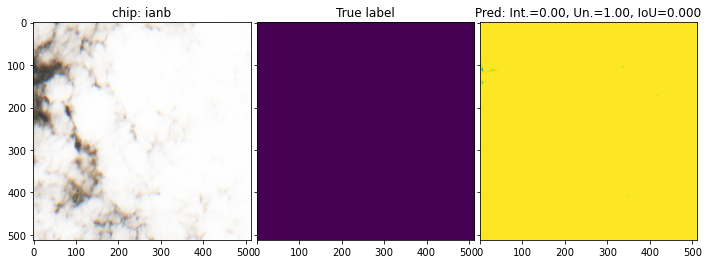

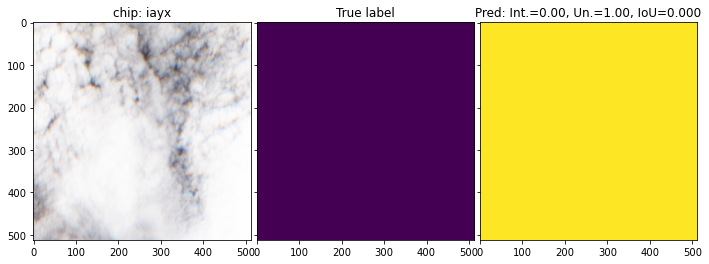

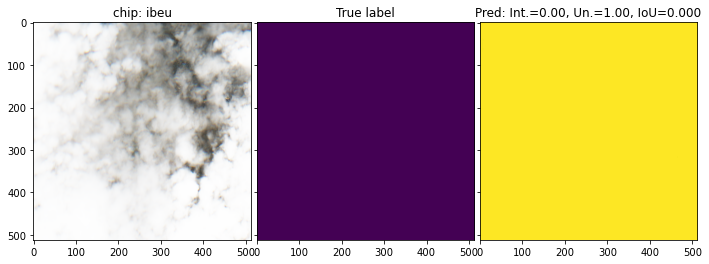

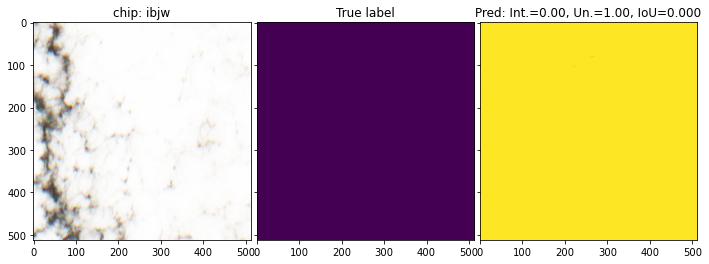

In [56]:
# plot bad predictions
nplt = 10

load_features = True
load_labels = True
load_prediction = True

PREDICTION_DIR = Path.cwd().parent.resolve() / "trained_models/unet/4band_originaldata_resnet18_bce_vfrc_customfeats_None_2022-01-17/predictions/"

bad_chips_mask = np.isin(data['chip_ids'], BAD_CHIPS)

worst_preds = np.abs(data['intersection']-data['union'])[~bad_chips_mask]
chip_ids = data['chip_ids'][~bad_chips_mask]

# Sort indices by desired property  
inds_linear = np.arange(len(inds_plot))

# inds_sort = np.argsort(mean_bands[:, sort_by_band_ind]) #[::-1] # brightest first
inds_sort = np.argsort(worst_preds)[::-1] 


chip_ids_plt = chip_ids[inds_sort]

for iplt in range(nplt):

    chip_id = chip_ids_plt[iplt]

    chip = chip_vis.ImageChip(chip_id, 
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)
    chip.plot_true_colour()
#     print(np.mean(chip.image_array[chip.labels == 0], axis=(0,1)))
#     # print(chip.labels)
    
#     fig, ax = plt.subplots(1, 2, figsize=(2*4, 4),
#                            sharex=True, sharey=True, squeeze=False)

#     # True color
#     ax[0, 0].imshow(chip.image_array[..., 0])
#     ax[0, 1].imshow(np.log(chip.image_array[..., 0]))
 

In [4]:
import glob

NUMPY_ARRAY_DIR = "../data/big_numpy_arrays/nchips_100/"
chunksize = 100

# arrays_want = ['images', 'labels', 'preds', 'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU', 'chip_ids']
# arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'B02', 'B03', 'B04', 'labels', 'preds', 'intersection', 'union'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]
arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'intersection', 'union'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]

# arrays_want = ['lat', 'lon', 'dlat', 'dlon',  'chip_ids', 'intersection', 'union', 'B02', 'labels'] #'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU',]

nchips_total = 11748
nchunks_use = 999
data = {}
for array_name in arrays_want:
    
    files = sorted(glob.glob(NUMPY_ARRAY_DIR + f"{array_name}*"))

    array_list = []
    for f_ in files[:nchunks_use]:
        array_list.append(np.load(f_))
        
    data[array_name] = np.concatenate(array_list, axis=0)
    
# bad_chips_mask = np.isin(data['chip_ids'], BAD_CHIPS)
# for k, v in data.items():
#     print(k, v.shape, v[~bad_chips_mask].shape)
#     data[k] = v[~bad_chips_mask]



# BAD_CHIPS = np.loadtxt("../data/BAD_CHIP_DATA/BAD_CHIP_LABEL_IDS.txt", dtype=str)
# in_bad_chips = np.isin(data['chip_ids'], BAD_CHIPS)

# data['inds_orig'] = np.arange(data[arrays_want[0]].shape[0])
# data['worst_preds'] = np.abs(data['intersection']-data['union'])

# inds_sort = np.argsort(data['worst_preds'])[::-1]
# print(data['worst_preds'][inds_sort])
# np.savetxt("../data/BAD_CHIP_DATA/worst_preds_chip_ids.txt", list(data['chip_ids'][inds_sort]), fmt='%s')
# np.savetxt("../data/BAD_CHIP_DATA/worst_preds_int-union.txt", list(data['worst_preds'][inds_sort]), fmt='%.4f')

# for k, v in data.items():
#     data[k] = v[~in_bad_chips]
#     print(k, data[k].shape)
#     # Remove bad chips



In [45]:
np.loadtxt("../data/BAD_CHIP_DATA/worst_preds_chip_ids.txt", dtype=str)
np.loadtxt("../data/BAD_CHIP_DATA/worst_preds_int-union.txt", dtype=float)

array([1., 1., 1., ..., 0., 0., 0.])

In [8]:
%%file ../scripts/sort_bad_predictions.py
import numpy as np
import math

# sort GBM predictions
def intersection_and_union(pred, true, pcut=0.5):
    """                                                                                         
    Calculates intersection and union for an image.                                             
    Args:                                                                                       
        pred (np.array): an array predictions                                                   
        true (torc.Tensor): a tensor of labels                                                  
    Returns:                                                                                    
        intersection (int): total intersection of pixels                                        
        union (int): total union of pixels                                                      
    """

    # Intersection and union totals                                                             
    pred_flattened = ((pred > 0.5) * 1).reshape(pred.shape[0], -1)
    true_flattened = true.reshape(true.shape[0], -1)
    
    intersection = np.sum(true_flattened*pred_flattened, axis=1)/pred_flattened.shape[1]
    union = np.sum((true_flattened+pred_flattened)>0, axis=1)/pred_flattened.shape[1]

    return intersection, union

chunksize=100
nchips_total = 11748
nchunks_use = 999

BAD_CHIPS = np.loadtxt("../data/BAD_CHIP_DATA/BAD_CHIP_LABEL_IDS.txt", dtype=str)
NUMPY_ARRAY_DIR = "../data/big_numpy_arrays/nchips_100/"

# use_feature_preds = False
use_feature_preds = True

preds_str = 'preds'
if use_feature_preds:
    preds_str += '_gbm'


for ichunk in range(min(nchunks_use, math.ceil(nchips_total/chunksize))):  
    
    print(f"\nRunning on chunk {ichunk}\n")
    
    inds_start = ichunk*chunksize
    inds_end = inds_start+chunksize 
    if inds_end > 11748:
        inds_end = 11748  
                 
    file_head = NUMPY_ARRAY_DIR
    file_tail = f"_{inds_start:06d}_{inds_end:06d}.npy"
             
    # Load in all data for chunk
    labels_ichunk      = np.load(NUMPY_ARRAY_DIR + "labels" + file_tail)
    preds_ichunk       = np.load(NUMPY_ARRAY_DIR + preds_str + file_tail)
    chip_ids_ichunk    = np.load(NUMPY_ARRAY_DIR + "chip_ids" + file_tail)

    print(labels_ichunk.shape, preds_ichunk.shape)
    intersection_ichunk, union_ichunk = intersection_and_union(preds_ichunk, labels_ichunk, pcut=0.5)
    
    intersection_union_ichunk = np.abs(intersection_ichunk-union_ichunk)
    if ichunk==0:
        chip_ids    = chip_ids_ichunk
        intersection_union = intersection_union_ichunk

    else:
        chip_ids    = np.concatenate((chip_ids, chip_ids_ichunk), axis=0)
        intersection_union = np.concatenate((intersection_union, intersection_union_ichunk), axis=0)

inds_sort = np.argsort(intersection_union)[::-1]

np.savetxt("../data/BAD_CHIP_DATA/worst_preds_gbm_chip_ids.txt", list(chip_ids), fmt='%s')
np.savetxt("../data/BAD_CHIP_DATA/worst_preds_gbm_int-union.txt", list(intersection_union), fmt='%.4f')


Overwriting ../scripts/sort_bad_predictions.py


In [ ]:
inds_sort = np.argsort(intersection_union)[::-1]
print(intersection_union[inds_sort])
np.savetxt("../data/BAD_CHIP_DATA/worst_preds_gbm_chip_ids.txt", list(chip_ids), fmt='%s')
np.savetxt("../data/BAD_CHIP_DATA/worst_preds_gbm_int-union.txt", list(intersection_union), fmt='%.4f')


In [5]:
def intersection_and_union(pred, true, pcut=0.5):
    """                                                                                         
    Calculates intersection and union for an image.                                             
    Args:                                                                                       
        pred (np.array): an array predictions                                                   
        true (torc.Tensor): a tensor of labels                                                  
    Returns:                                                                                    
        intersection (int): total intersection of pixels                                        
        union (int): total union of pixels                                                      
    """

    # Intersection and union totals                                                             
    pred_flattened = ((pred > 0.5) * 1).reshape(pred.shape[0], -1)
    true_flattened = true.reshape(true.shape[0], -1)

    intersection = np.sum(true_flattened*pred_flattened, axis=1)/pred_flattened.shape[1]
    union = np.sum((true_flattened+pred_flattened)>0, axis=1)/pred_flattened.shape[1]

    return intersection, union


In [6]:
def get_array(filepath):
    """Put images in xarray.DataArray format"""
    im_arr = np.array(Image.open(filepath))
    return im_arr

def to_xarray(im_arr):
    """Put images in xarray.DataArray format"""

    return xarray.DataArray(im_arr, dims=["y", "x"])


def true_color_img(img, use_bands=["B04", "B03", "B02"]):
    """Given the path to the directory of Sentinel-2 chip feature images,
    plots the true color image"""
    
    red = to_xarray(img[2])
    green = to_xarray(img[1])
    blue = to_xarray(img[0])
    
    return ms.true_color(r=red, g=green, b=blue)

    

In [7]:
def rank_predictions(intersection, union):
    
    preds_ranking = np.abs(intersection-union)
    
    return preds_ranking
    
def get_stats_bands_masked(images, labels, mask):
    
    max_bands = np.max(images*mask, axis=(-2,-1))
    min_bands = np.min(images*mask, axis=(-2,-1))
    mean_bands = np.sum(images*mask, axis=(-2,-1))/np.sum(mask, axis=(-2,-1))

    return min_bands, max_bands, mean_bands

def check_true_cloud(images, labels):
    # True positives, where label says cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 1
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac

    min_bands, max_bands, mean_bands = get_stats_bands_masked(images, labels, dm)

    true_cloud = (cloud_cover_frac > .2) & np.any(max_bands > min_cloud_band_cut_val, axis=1) 
        
    return true_cloud

def check_true_land(images, labels):
    # Remove negatives, where label says no cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 0
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac
    
    min_bands, max_bands, mean_bands = get_stats_bands_masked(images, labels, dm)

    true_land = (land_cover_frac > 0.2) & np.any(max_bands < max_land_band_cut_val, axis=1)
        
    return true_land


def check_all_positive(images, labels):
    # True positives, where label says cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 1
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac

    true_cloud = (cloud_cover_frac == 1.) 
        
    return true_cloud

def check_all_negative(images, labels):
    # True positives, where label says cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 0
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac

    true_cloud = (cloud_cover_frac == 0.) 
        
    return true_cloud

def check_false_positive(images, labels):
    # True positives, where label says cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 1
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac

    min_bands, max_bands, mean_bands = get_stats_bands_masked(images, labels, dm)

    true_cloud = (cloud_cover_frac == 1.) & np.any(mean_bands < mean_cloud_band_cut_val, axis=1) 
        
    return true_cloud

def check_false_negative(images, labels):
    # True positives, where label says cloud and value of cloud labels is larger than cutoff
    dm = labels[:, None, :, :] == 0
    
    cloud_cover_frac = np.sum(dm, axis=(-3, -2,-1)) / (dm.shape[-2] * dm.shape[-1])
    land_cover_frac = 1. - cloud_cover_frac

    min_bands, max_bands, mean_bands = get_stats_bands_masked(images, labels, dm)

    true_cloud = (land_cover_frac == 1.) & np.any(max_bands > max_cloud_band_cut_val, axis=1) 
        
    return true_cloud


In [12]:
BAD_CHIPS = np.loadtxt("../data/BAD_CHIP_DATA/BAD_CHIP_LABEL_IDS.txt", dtype=str)

NUMPY_ARRAY_DIR = "../data/big_numpy_arrays/nchips_100/"

use_feature_preds = False
# use_feature_preds = True

preds_str = 'preds'
if use_feature_preds:
    preds_str += '_gbm'
    
worst_preds_all = np.abs(data['intersection']-data['union'])
print(worst_preds_all.min(), worst_preds_all.max())

# Look at bands, labels, and predictions of specified chips
import metrics 
verbose = False
nchips_total = 999 #1700 #48

plot_all_in_range = True
# plot_all_in_range = False

# plot_good_chips = True
plot_good_chips = False

# plot_all_cloud = True
plot_all_cloud = False

# plot_all_land = True
plot_all_land = False

save_files = False
def in_desired_range(val, min_val, max_val):
    return (val >= min_val) & (val <= max_val)



# Bad chips are near 1
min_val = 0.1
max_val = 10.0

# good chips are near 0
# min_val = 0.0
# max_val = 0.5

# print(f"Number of chips above min val: {(data['worst_preds']>min_val).sum()}")

# very cloudy chip mean cloud band vals =  [2538.65665373 2554.36472408 2431.32573507 3773.70541711]

num_bands = 4
max_land_band_cut_val = np.zeros(num_bands) + 2000.
min_land_band_cut_val = np.zeros(num_bands) + 2000.

min_cloud_band_cut_val =  np.zeros(num_bands) + 2000.
max_cloud_band_cut_val =  np.zeros(num_bands) + 4000.

mean_cloud_band_cut_val =  np.zeros(num_bands) + 2000. 


for ichunk in range(min(nchunks_use, math.ceil(nchips_total/chunksize))):  
    
    print(f"\nRunning on chunk {ichunk}\n")
    
    inds_start = ichunk*chunksize
    inds_end = inds_start+chunksize 
    if inds_end > 11748:
        inds_end = 11748  
                
    # arrays_want = ['images', 'labels', 'preds', 'labels_mean', 'preds_mean', 'intersection', 'union', 'IoU', 'chip_ids']
    arrays_want = ['labels_mean', 'preds_mean', 'intersection', 'union', 'IoU', 'chip_ids']

    nchips_total = 11748
             
    file_head = NUMPY_ARRAY_DIR
    file_tail = f"_{inds_start:06d}_{inds_end:06d}.npy"
             
    # Load in all data for chunk
    images_ichunk      = np.load(NUMPY_ARRAY_DIR + "images" + file_tail)
    labels_ichunk      = np.load(NUMPY_ARRAY_DIR + "labels" + file_tail)
    preds_ichunk       = np.load(NUMPY_ARRAY_DIR + preds_str + file_tail)
    chip_ids_ichunk    = np.load(NUMPY_ARRAY_DIR + "chip_ids" + file_tail)

    intersection_ichunk, union_ichunk = intersection_and_union(preds_ichunk, labels_ichunk, pcut=0.5)

    worst_preds_ichunk = rank_predictions(intersection_ichunk, union_ichunk)
    chip_in_bad_ichunk = np.isin(chip_ids_ichunk, BAD_CHIPS)
    
    min_bands_ichunk, max_bands_ichunk, mean_bands_ichunk = get_stats_bands_masked(
        images_ichunk,
        labels_ichunk,
        (labels_ichunk < 2)[:, None, ...],
    )
    
    all_cloud = check_all_positive(images_ichunk, labels_ichunk)
    all_land = check_all_negative(images_ichunk, labels_ichunk)

    true_cloud = check_true_cloud(images_ichunk, labels_ichunk)
    true_land  = check_true_land(images_ichunk, labels_ichunk)
    
    fp = check_false_positive(images_ichunk, labels_ichunk)
    fn = check_false_negative(images_ichunk, labels_ichunk)

    # Select desired chips that match criteria
    inds_all = np.arange(true_cloud.shape[0])
    
    in_range =  in_desired_range(worst_preds_ichunk, min_val, max_val)
 
    dm = labels_ichunk ==1
    cloud_cover_frac = np.sum(dm, axis=(-2,-1)) / (dm.shape[-2] * dm.shape[-1])
    
    if plot_all_in_range:
        inds_plot_ichunk = inds_all[in_range & ~chip_in_bad_ichunk]

    elif plot_all_cloud:
        inds_plot_ichunk = inds_all[all_cloud & ~chip_in_bad_ichunk]
        
    elif plot_all_land:
        inds_plot_ichunk = inds_all[all_land & ~chip_in_bad_ichunk]
                
    elif plot_good_chips:
        inds_plot_ichunk = inds_all[true_cloud & true_land & in_range & ~chip_in_bad_ichunk]
        
    else:
        inds_plot_ichunk = inds_all[~true_cloud & ~true_land  & (cloud_cover_frac==0) & in_range & ~chip_in_bad_ichunk]
        # inds_plot = inds_all[fp | fn]# & ~chip_in_bad]
       
    print(f"Number of chips after selection {inds_plot_ichunk.shape}")
   
    if ichunk==0:
        inds_plot = inds_plot_ichunk
        min_bands, max_bands, mean_bands = min_bands_ichunk[inds_plot_ichunk], max_bands_ichunk[inds_plot_ichunk], mean_bands_ichunk[inds_plot_ichunk]
        chip_ids    = chip_ids_ichunk[inds_plot_ichunk]
        images      = images_ichunk[inds_plot_ichunk]
        labels      = labels_ichunk[inds_plot_ichunk]
        preds       = preds_ichunk[inds_plot_ichunk]
        worst_preds = worst_preds_ichunk[inds_plot_ichunk]

    else:
        # very slow, I should fix this
        inds_plot   = np.concatenate((inds_plot, inds_plot_ichunk), axis=0)
        min_bands   = np.concatenate((min_bands, min_bands_ichunk[inds_plot_ichunk]), axis=0)
        max_bands   = np.concatenate((max_bands, max_bands_ichunk[inds_plot_ichunk]), axis=0)
        mean_bands  = np.concatenate((mean_bands, mean_bands_ichunk[inds_plot_ichunk]), axis=0)
        chip_ids    = np.concatenate((chip_ids, chip_ids_ichunk[inds_plot_ichunk]), axis=0)
        images      = np.concatenate((images, images_ichunk[inds_plot_ichunk]), axis=0)
        labels      = np.concatenate((labels, labels_ichunk[inds_plot_ichunk]), axis=0)
        preds       = np.concatenate((preds, preds_ichunk[inds_plot_ichunk]), axis=0)
        worst_preds = np.concatenate((worst_preds, worst_preds_ichunk[inds_plot_ichunk]), axis=0)

# free up space
del images_ichunk
del labels_ichunk
del preds_ichunk

# # Sort indices by desired property  
# inds_linear = np.arange(len(inds_plot))
# inds_sort = np.argsort(mean_bands[:, sort_by_band_ind]) #[::-1] # brightest first
# inds_plot = inds_linear[inds_sort]
# # print(inds_plot.shape, mean_bands[inds_plot])
    
# inds_plot = inds_plot[:nplt_max]

# nplt = len(inds_plot)
# fig, ax = plt.subplots(nplt, 3, figsize=(nx*4, nplt*4),
#                    sharex=True, sharey=True, squeeze=False)

# for iplt, ind_plot in enumerate(inds_plot):
#     print(iplt, ind_plot)
#     # True color
#     ax[iplt, 0].imshow(true_color_img(images[ind_plot]))
#     ax[iplt, 0].set_title(f"{chip_ids[ind_plot]}")

#     # Label panel
#     if chip.labels is not None:
#         ax[iplt, 1].imshow(labels[ind_plot], vmin=0, vmax=1, interpolation='none')
#         ax[iplt, 1].set_title(f"True label")

#     # Prediction panel
#     if preds is not None:
#         pred_title_string = "Pred"
#         # if labels is not None:
#             # intersection, union = metrics.intersection_and_union(preds[ind_plot], labels[ind_plot])
#             # IoU = intersection/union
#             # pred_title_string += f": Int.={intersection:.2f}, Un.={union:.2f}, IoU={IoU:.3f}"

#         ax[iplt, 2].imshow(preds[ind_plot], vmin=0, vmax=1, interpolation='none')
#         ax[iplt, 2].set_title(pred_title_string)

#     ax[iplt,0].axis('off')
#     ax[iplt,1].axis('off')
#     ax[iplt,2].axis('off')

#     if iplt % 10 == 0:
#         print("plotting", iplt)

# fig.subplots_adjust(hspace=0.1, wspace=0)

# if save_files:
#     plt.savefig(f"figures/bad_chips_ichunk{ichunk:03d}.pdf", bbox_inches='tight')
#     plt.close()

#     np.savetxt(f"figures/bad_chips_ichunk{ichunk:03d}.txt", bad_chip_names, fmt='%s')

0.0 1.0

Running on chunk 0



/tmp/ipykernel_218166/2348959396.py:11: RuntimeWarning: invalid value encountered in true_divide
  mean_bands = np.sum(images*mask, axis=(-2,-1))/np.sum(mask, axis=(-2,-1))


Number of chips after selection (12,)

Running on chunk 1

Number of chips after selection (15,)

Running on chunk 2

Number of chips after selection (1,)

Running on chunk 3

Number of chips after selection (3,)

Running on chunk 4

Number of chips after selection (9,)

Running on chunk 5

Number of chips after selection (5,)

Running on chunk 6

Number of chips after selection (4,)

Running on chunk 7

Number of chips after selection (13,)

Running on chunk 8

Number of chips after selection (16,)

Running on chunk 9

Number of chips after selection (20,)


(12,)
[0.79393387 0.64716339 0.56043243 0.44690323 0.4105072  0.22951126
 0.18267822 0.18095779 0.13441467 0.1096611  0.10399246 0.10216904]
Running on chunk 0
plotting 0
plotting 10


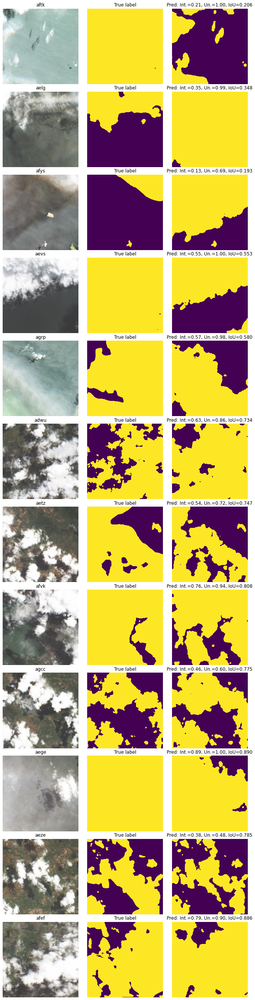

In [10]:
# save_files = True
save_files = False

date = '01-30-2021' 

plt_chunksize = 100
sort_by_band_ind = 1 # Sort plot images by min/max/mean of this band

nx = 3

nplt_chunks = math.ceil(len(inds_plot)/plt_chunksize)

nplt_max = plt_chunksize
# nplt_max = 20


# Sort indices by desired property  
inds_linear = np.arange(len(inds_plot))

# inds_sort = np.argsort(mean_bands[:, sort_by_band_ind]) #[::-1] # brightest first
inds_sort = np.argsort(worst_preds)[::-1] 

inds_plot_all = inds_linear[inds_sort]
print(inds_plot.shape)#, mean_bands[inds_plot_all])
print(worst_preds[inds_sort])
if save_files:
    # np.savetxt(f"figures/bad_chips_all_cloud.txt", chip_ids[inds_plot_all], fmt='%s')
    np.savetxt(f"figures/worst_{preds_str}_{date}.txt", chip_ids[inds_plot_all], fmt='%s')
   
for iplt_chunk in range(nplt_chunks):
    print(f"Running on chunk", iplt_chunk)
    ind_plt_start = iplt_chunk*plt_chunksize
    ind_plt_end = (iplt_chunk+1)*plt_chunksize
    ind_plt_end = min(ind_plt_end, len(inds_plot_all))
    
    inds_ploti = inds_plot_all[ind_plt_start:ind_plt_end]
    
    # plot only a few
    inds_ploti = inds_ploti[:nplt_max]

    nplt = len(inds_ploti)
    fig, ax = plt.subplots(nplt, 3, figsize=(nx*4, nplt*4),
                       sharex=True, sharey=True, squeeze=False)

    for iplt, ind_plot in enumerate(inds_ploti):
        # True color
        ax[iplt, 0].imshow(true_color_img(images[ind_plot]))
        ax[iplt, 0].set_title(f"{chip_ids[ind_plot]}")

        # Label panel
        if labels is not None:
            ax[iplt, 1].imshow(labels[ind_plot], vmin=0, vmax=1, interpolation='none')
            ax[iplt, 1].set_title(f"True label")

        # Prediction panel
        if preds is not None:
            pred_title_string = "Pred"
            if labels is not None:
                intersection, union = metrics.intersection_and_union(preds[ind_plot], labels[ind_plot])
                IoU = (intersection+1e-9)/(union+1e-9)
                pred_title_string += f": Int.={intersection:.2f}, Un.={union:.2f}, IoU={IoU:.3f}"

            ax[iplt, 2].imshow(preds[ind_plot], vmin=0, vmax=1, interpolation='none')
            ax[iplt, 2].set_title(pred_title_string)

        ax[iplt,0].axis('off')
        ax[iplt,1].axis('off')
        ax[iplt,2].axis('off')

        if iplt % 10 == 0:
            print("plotting", iplt)

    fig.subplots_adjust(hspace=0.1, wspace=0)

    if save_files:
        # plt.savefig(f"figures/bad_chips_{ind_plt_start:05d}_{ind_plt_end:05d}.pdf", bbox_inches='tight')
        plt.savefig(f"figures/worst_{preds_str}_{date}_{ind_plt_start:05d}_{ind_plt_end:05d}.pdf", bbox_inches='tight')

        plt.close()



In [277]:
# Append all bad predictions into one file
files = sorted(glob.glob("figures/bad_chips_ichunk*txt"))

for ii, f in enumerate(files):
    print(f)
    if ii==0:

        BAD_CHIPS = list(np.loadtxt(f, dtype=str))
        print(BAD_CHIPS)
    else:
        BAD_CHIPS += list(np.loadtxt(f, dtype=str))

print(BAD_CHIPS)

np.savetxt(f"figures/bad_chips_ALLCHUNKS.txt", BAD_CHIPS, fmt='%s')

figures/bad_chips_ichunk000.txt
['ahfi', 'akkb', 'alfq', 'alht', 'apiw', 'asaq', 'auza', 'bhfg', 'bkdx', 'blce', 'brzu', 'btbm', 'buqh']
figures/bad_chips_ichunk001.txt
figures/bad_chips_ichunk002.txt
figures/bad_chips_ichunk003.txt
figures/bad_chips_ichunk004.txt
figures/bad_chips_ichunk005.txt
figures/bad_chips_ichunk006.txt
figures/bad_chips_ichunk007.txt
figures/bad_chips_ichunk008.txt
figures/bad_chips_ichunk009.txt
figures/bad_chips_ichunk010.txt
figures/bad_chips_ichunk011.txt
['ahfi', 'akkb', 'alfq', 'alht', 'apiw', 'asaq', 'auza', 'bhfg', 'bkdx', 'blce', 'brzu', 'btbm', 'buqh', 'bxvp', 'byka', 'byoj', 'cive', 'ciwx', 'cjvz', 'ckgv', 'ckhd', 'ckim', 'clqu', 'cmdp', 'crjn', 'csrr', 'ctzz', 'cucj', 'cudp', 'cutk', 'cwee', 'ddpj', 'denk', 'dhzm', 'dmig', 'dmjj', 'dndl', 'doku', 'doww', 'dpmj', 'dqaf', 'dunj', 'dupb', 'duyk', 'dxue', 'dykg', 'dyrn', 'dysx', 'dzkm', 'ekiw', 'etzy', 'eylb', 'eyrd', 'eyvk', 'fmop', 'ggyg', 'gsks', 'hxdd', 'hxec', 'hxhj', 'hxlo', 'hxqm', 'hxqn', 'hxrn'

['ykuw',
 'ynbb',
 'yrwr',
 'ysmw',
 'ytlt',
 'ytpm',
 'ytux',
 'ytza',
 'yumd',
 'yvnf',
 'zblc',
 'zdyz']

In [183]:
# Look at bands, labels, and predictions of specified chips
import metrics 
verbose = False
chunksize = 1000

def in_desired_range(val, min_val, max_val):
    return (val >= min_val) & (val <= max_val)

worst_preds = np.abs(data['intersection']-data['union'])
# worst_preds = np.abs(data['labels_mean'] - data['preds_mean'])
inds_worst = np.argsort(worst_preds)[::-1]

nplt = 100
nx_each = 3
ncol_plot = 1

# Bad chips are near 1
min_val = 0.0
max_val = 1.0

# good chips are near 0
# min_val = 0.0
# max_val = 0.5

print(f"Number of chips above min val: {(worst_preds>min_val).sum()}")

# very cloudy chip mean cloud band vals =  [2538.65665373 2554.36472408 2431.32573507 3773.70541711]

max_cloud_band_cut_val = [2000., 2000., 2000., 2000.] 
mean_cloud_band_cut_val = [2000., 2000., 2000., 2000.] 


bad_chip_files = sorted(glob.glob("../data/BAD_CHIP_DATA/*bad*txt"))
# BAD_CHIPS = []
for ii, f in enumerate(bad_chip_files):
    if ii==0:
        BAD_CHIPS = list(np.loadtxt(f, dtype=str))
    else:
        BAD_CHIPS.append(list(np.loadtxt(f, dtype=str)))

print(BAD_CHIPS, 'hzcr' in BAD_CHIPS)
BAD_CHIP_ITERATION = len(bad_chip_files)


i = 0
iplt = 0
fig, ax = plt.subplots(nplt, 3, figsize=(nx*4, nplt*4),
                       sharex=True, sharey=True, squeeze=False)

bad_chip_names = []
while iplt < nplt and i < len(inds_worst):
    
    indx = inds_worst[i]
    i += 1
    if i % 100 ==0:
        print("chip ", i)
        
    if not in_desired_range(worst_preds[indx], min_val, max_val):
        continue
 
    chip_id = data['chip_ids'][indx]
    if chip_id in BAD_CHIPS: # SKIP BAD CHIPS
        continue
        
    ichunk_start = (indx // chunksize)*chunksize
    ichunk_end = ichunk_start+chunksize
    if ichunk_end > 11748:
        ichunk_end = 11748
    indx_inchunk = indx % chunksize

    image_array = np.load(
        NUMPY_ARRAY_DIR + f"images_{ichunk_start:06d}_{ichunk_end:06d}.npy",
        mmap_mode='r',
    )[indx_inchunk]
    labels = np.load(
        NUMPY_ARRAY_DIR + f"labels_{ichunk_start:06d}_{ichunk_end:06d}.npy",
        mmap_mode='r',
    )[indx_inchunk]
    preds = np.load(
        NUMPY_ARRAY_DIR + f"preds_{ichunk_start:06d}_{ichunk_end:06d}.npy",
        mmap_mode='r',
    )[indx_inchunk]
          
    # print("\nChecking chip ", data['chip_ids'][indx])    
 

    dm_cloud = labels == 1
    cloud_cover_frac = np.sum(dm_cloud)/dm_cloud.flatten().shape[0]
    land_cover_frac = 1. - cloud_cover_frac

    if cloud_cover_frac > 0:
        max_cloud_bands = np.max(image_array[:, dm_cloud], axis=-1)
        mean_cloud_bands = np.mean(image_array[:, dm_cloud], axis=-1)

        
    if land_cover_frac > 1:
        
        mean_land_bands = np.mean(image_array[:, ~dm_cloud], axis=-1)
        max_land_bands = np.max(image_array[:, ~dm_cloud], axis=-1)

    # Remove true positives, where label says cloud and value of cloud labels is larger than cutoff
    if (cloud_cover_frac > 0) and (max_cloud_bands > max_cloud_band_cut_val).any():
        # no clouds in image
        continue

    # Remove true negatives, where label says no cloud cloud and value of cloud labels is larger than cutoff
    if (land_cover_frac > 0.) and (max_land_bands < max_cloud_band_cut_val).any():
        # no clouds in image
        continue
 
    if verbose:
        if cloud_cover_frac > 0:
            print("Cloud mean = ", mean_cloud_bands)
            print("Cloud max = ", max_cloud_bands)

        if land_cover_frac > 0:
            print("Not cloud mean = ", mean_land_bands)
            print("Not cloud max = ", max_land_bands)

    
    
    # True color
    ax[iplt, 0].imshow(true_color_img(image_array))
    ax[iplt, 0].set_title(f"{chip_id}")

    # Label panel
    if chip.labels is not None:
        ax[iplt, 1].imshow(labels, vmin=0, vmax=1, interpolation='none')
        ax[iplt, 1].set_title(f"True label")

    # Prediction panel
    if chip.preds is not None:
        pred_title_string = "Pred"
        if chip.labels is not None:
            intersection, union = metrics.intersection_and_union(preds, labels)
            IoU = intersection/union
            pred_title_string += f": Int.={intersection:.2f}, Un.={union:.2f}, IoU={IoU:.3f}"

        ax[iplt, 2].imshow(preds, vmin=0, vmax=1, interpolation='none')
        ax[iplt, 2].set_title(pred_title_string)
        
    ax[iplt,0].axis('off')
    ax[iplt,1].axis('off')
    ax[iplt,2].axis('off')
 
    bad_chip_names.append(str(chip_id))
    if iplt % 10 == 0:
        print("plotting", iplt)
    iplt+=1
    
fig.subplots_adjust(hspace=0.1, wspace=0)
plt.savefig(f"figures/bad_chips_{BAD_CHIP_ITERATION}.pdf", bbox_inches='tight')
plt.close()

# print(f"bad_chips_{BAD_CHIP_ITERATION}", bad_chip_names)
np.savetxt(f"figures/bad_chips_{BAD_CHIP_ITERATION}.txt", bad_chip_names, fmt='%s')

Number of chips above min val: 10614
['hzcr', 'ldtr', 'ibsk', 'ibpy', 'ibjw', 'ibhw', 'ibeu', 'iayx', 'hzzt', 'hzxh', 'hyrk', 'hyqb', 'hxyc', 'hxxp', 'hxlr', 'hxlf', 'emnp', 'clvy', 'yykc', 'cdug', 'ibtp', 'nnnt', 'qjbd', 'hxzc', 'hxzp', 'enhp', 'iamy', 'ianb', 'ibub', 'iacl', 'eojj', 'qrrb', 'ibmj', 'iboy', 'iajb', 'wzkj', 'hxrz', 'cpod', 'iasn', 'ibek', 'iblr', 'ibhj', 'ydou', 'hynv', 'hsfa', 'hztm', 'susw', 'eyjs', 'iasx', 'aisf', 'rbuz', 'pfmm', 'foxl', 'hzbr', 'ibou', 'hycr', 'ykfb', 'snvl', 'hzta', 'kgqy', 'vpzw', 'hzgu', 'hzsu', 'wyhb', 'emih', 'hxwk', 'hzwe', 'zwpu', 'duix', 'djor', 'ibpg', 'hxno', 'iauq', 'dcmm', 'usjl'] True
plotting 0
plotting 10
chip  100
plotting 20
plotting 30
plotting 40
chip  200
plotting 50
chip  300
plotting 60
plotting 70
chip  400
plotting 80
chip  500
plotting 90


In [159]:
# Look at bands, labels, and predictions of specified chips

import metrics 
worst_preds = np.abs(data['intersection']-data['union'])
# worst_preds = np.abs(data['labels_mean'] - data['preds_mean'])
inds_worst = np.argsort(worst_preds)[::-1]

load_features = True
load_labels = True
load_prediction = True

nplt = 250
nx_each = 3
ncol_plot = 1

# Bad chips are near 1
min_val = 0.0
max_val = 1.0

# good chips are near 0
# min_val = 0.0
# max_val = 0.5

verbose = False
# very cloudy chip mean cloud band vals =  [2538.65665373 2554.36472408 2431.32573507 3773.70541711]

max_cloud_band_cut_val = [2000., 2000., 2000., 2000.] 

bad_chip_files = sorted(glob.glob("../data/BAD_CHIP_DATA/*bad*txt"))
# BAD_CHIPS = []
for ii, f in enumerate(bad_chip_files):
    if ii==0:
        BAD_CHIPS = list(np.loadtxt(f, dtype=str))
    else:
        BAD_CHIPS.append(list(np.loadtxt(f, dtype=str)))

print(BAD_CHIPS, 'hzcr' in BAD_CHIPS)
BAD_CHIP_ITERATION = len(bad_chip_files)

print(f"Number of chips above min val: {(worst_preds>min_val).sum()}")

def in_desired_range(val, min_val, max_val):
    return (val >= min_val) & (val <= max_val)

i = 0
iplt = 0
fig, ax = plt.subplots(nplt, 3, figsize=(nx*4, nplt*4),
                       sharex=True, sharey=True, squeeze=False)

bad_chip_names = []
while iplt < nplt and i < len(inds_worst):
    indx = inds_worst[i]
    i += 1
    if i % 10 ==0:
        print(i)
    if not in_desired_range(worst_preds[indx], min_val, max_val):
        continue
        
    
        
    # print("\nChecking chip ", data['chip_ids'][indx])    
    chip_id = data['chip_ids'][indx]
    if chip_id in BAD_CHIPS: # SKIP BAD CHIPS
        continue
        
    chip = {}
    chip = chip_vis.ImageChip(chip_id, 
                              DATA_DIR, PREDICTION_DIR,
                              load_features=load_features, 
                              load_prediction=load_prediction,
                             load_labels=load_labels)

    
    dm_cloud = chip.labels == 1
    cloud_cover_frac = np.sum(dm_cloud)/dm_cloud.flatten().shape[0]
    land_cover_frac = 1. - cloud_cover_frac

    if cloud_cover_frac > 0:
        max_cloud_bands = np.max(chip.image_array[dm_cloud, ...], axis=0)
        mean_cloud_bands = np.mean(chip.image_array[dm_cloud, ...], axis=0)

        
    if land_cover_frac > 1:
        
        mean_land_bands = np.mean(chip.image_array[~dm_cloud, ...], axis=0)
        max_land_bands = np.max(chip.image_array[~dm_cloud, ...], axis=0)

    # Remove true positives, where label says cloud and value of cloud labels is larger than cutoff
    if (cloud_cover_frac > 0):# and (max_cloud_bands > max_cloud_band_cut_val).any():
        # no clouds in image
        continue

    # Remove true negatives, where label says no cloud cloud and value of cloud labels is larger than cutoff
    if (land_cover_frac > 0.) and (max_land_bands < max_cloud_band_cut_val).any():
        # no clouds in image
        continue
 
    if verbose:
        if cloud_cover_frac > 0:
            print("Cloud mean = ", mean_cloud_bands)
            print("Cloud max = ", max_cloud_bands)

        if land_cover_frac > 0:
            print("Not cloud mean = ", mean_land_bands)
            print("Not cloud max = ", max_land_bands)

        print("plotting chip ", data['chip_ids'][indx], iplt)
    
    # True color
    ax[iplt, 0].imshow(chip.true_colour())
    ax[iplt, 0].set_title(f"{chip.chip}")

    # Label panel
    if chip.labels is not None:
        ax[iplt, 1].imshow(chip.labels, vmin=0, vmax=1, interpolation='none')
        ax[iplt, 1].set_title(f"True label")

    # Prediction panel
    if chip.preds is not None:
        pred_title_string = "Pred"
        if chip.labels is not None:
            chip.intersection, chip.union = metrics.intersection_and_union(chip.preds, chip.labels)
            chip.IoU = chip.intersection/chip.union
            pred_title_string += f": Int.={chip.intersection:.2f}, Un.={chip.union:.2f}, IoU={chip.IoU:.3f}"

        ax[iplt, 2].imshow(chip.preds, vmin=0, vmax=1, interpolation='none')
        ax[iplt, 2].set_title(pred_title_string)
        
    ax[iplt,0].axis('off')
    ax[iplt,1].axis('off')
    ax[iplt,2].axis('off')
 
    bad_chip_names.append(str(chip.chip))
    if iplt % 10 == 0:
        print(iplt)
    iplt+=1
    
fig.subplots_adjust(hspace=0.1, wspace=0)
plt.savefig(f"figures/bad_chips_{BAD_CHIP_ITERATION}.pdf", bbox_inches='tight')
plt.close()

print(bad_chip_names)
np.savetxt(f"figures/bad_chips_{BAD_CHIP_ITERATION}.txt", bad_chip_names, fmt='%s')

['hzcr', 'ldtr', 'ibsk', 'ibpy', 'ibjw', 'ibhw', 'ibeu', 'iayx', 'hzzt', 'hzxh', 'hyrk', 'hyqb', 'hxyc', 'hxxp', 'hxlr', 'hxlf', 'emnp', 'clvy', 'yykc', 'cdug', 'ibtp', 'nnnt', 'qjbd', 'hxzc', 'hxzp', 'enhp', 'iamy', 'ianb', 'ibub', 'iacl', 'eojj', 'qrrb', 'ibmj', 'iboy', 'iajb', 'wzkj', 'hxrz', 'cpod', 'iasn', 'ibek', 'iblr', 'ibhj', 'ydou', 'hynv', 'hsfa', 'hztm', 'susw', 'eyjs', 'iasx', 'aisf', 'rbuz', 'pfmm', 'foxl', 'hzbr', 'ibou', 'hycr', 'ykfb', 'snvl', 'hzta', 'kgqy', 'vpzw', 'hzgu', 'hzsu', 'wyhb', 'emih', 'hxwk', 'hzwe', 'zwpu', 'duix', 'djor', 'ibpg', 'hxno', 'iauq', 'dcmm', 'usjl'] True
Number of chips above min val: 10614


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7f4737e661f0> (for post_execute):


KeyboardInterrupt: 

In [85]:
a = np.array([0.0, 0.0])
b = np.array([1.0, 1.0])

(b>a).any()

True

array([ True,  True])

TypeError: unsupported operand type(s) for +: 'PosixPath' and 'str'

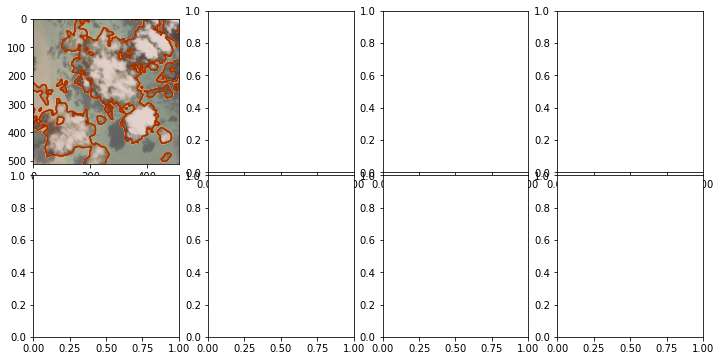

In [48]:
def display_chips(chips, nplt=None, figsize=None):
    
    if nplt is None:
        nplt = len(chips)
        
    cmap_true = plt.cm.Oranges
    cmap_pred = plt.cm.Blues
    
    nx = int(np.sqrt(nplt))
    ny = math.ceil(nplt/nx)
    if figsize is None:
        figsize=(nx*3*2, ny*3)
        
    fig, ax = plt.subplots(ny, nx*2, figsize=figsize)

    plt.subplots_adjust(hspace=0.02, wspace=0.2) 
    
    for iplt in range(nplt):
        iy = iplt // nx
        ix = (iplt % nx) * 2 
        
        chip = chips.iloc[iplt]
        
        imi = load_image(chip.chip_id) 
        imi_rgb = true_color_img(imi)
        imi_label = np.array(Image.open(chip.label_path))

        ax[iy, ix].imshow(imi_rgb)
        ax[iy, ix].imshow(imi_label, vmin=0, vmax=1, cmap=cmap_true, alpha=0.2)
        ax[iy, ix].contour(imi_label, vmin=0, vmax=1, cmap=cmap_true)

        label_predict_path = PREDICTION_DIR + chip.chip_id + '.tif'
        label_exists = os.path.exists(label_predict_path)
        
        if label_exists:
            imi_label_predict = np.array(Image.open(label_predict_path))
            ax[iy, ix+1].imshow(imi_label_predict, vmin=0, vmax=1, cmap=cmap_pred, alpha=0.2)
            ax[iy, ix+1].contour(imi_label_predict, vmin=0, vmax=1, cmap=cmap_pred)

        ax[iy, ix].set_title(f"Chip {chip.chip_id}\n(Location: {chip.location})")


    plt.tight_layout()
    plt.show()

nplt = 4
chips = train_meta.iloc[:nplt]

display_chips(chips, nplt=None)


In [39]:
# Optimal IoU given a fraction of bad masks


frac_err_positive_class = 0.5 #fraction that bad mask is all positive (all negative - 1-frac)
avg_cloud_cover = 0.621644 # average of labelled data
print("Average cloud cover in labelled data is", avg_cloud_cover)

fracs = [0.0, 0.025, 0.05, 0.1, 0.2]
for frac_bad_masks in fracs:

    # In general bad masks are completely flipped
    # Assume perfect prediction for cloud cover
    intersection_bad_avg = frac_err_positive_class * avg_cloud_cover 
    union_bad_avg = avg_cloud_cover * (1-frac_err_positive_class) + frac_err_positive_class


    intersection_bad_total = frac_bad_masks * intersection_bad_avg
    union_bad_total = frac_bad_masks * union_bad_avg

    intersection_good_total = (1-frac_bad_masks) * avg_cloud_cover
    union_good_total = (1-frac_bad_masks) * avg_cloud_cover

    IoU_bad = intersection_bad_total/union_bad_total
    IoU_good = intersection_good_total/union_good_total

    IoU_optimal = (intersection_bad_total + intersection_good_total)/(union_bad_total + union_good_total)
    print(f"Optimal IoU given {frac_bad_masks*100}% bad masks is {IoU_optimal}")

Average cloud cover in labelled data is 0.621644


ZeroDivisionError: float division by zero

### Look at label distributions

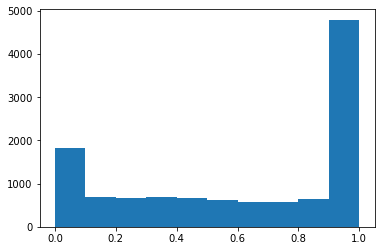

In [23]:
# nchips_use = 100
nchips_use = len(train_meta)

load_features=False

cloud_cover_frac = np.zeros(nchips_use)
for i in range(nchips_use):
    chip = chip_vis.ImageChip(train_meta.iloc[i].chip_id, DATA_DIR, load_features=load_features)
    # chip.plot_true_colour()

    
    # print(chip.image_array)
    cloud_cover_frac[i] = chip.labels.mean()
    
plt.hist(cloud_cover_frac);
    

Number of chips with 0% (100%) cloud cover:  787 2998


(array([ 957.,  143.,  117.,  100.,   88.,   78.,   85.,   78.,   98.,
          69.,   65.,   67.,   72.,   74.,   68.,   87.,   62.,   59.,
          71.,   65.,   67.,   70.,   61.,   64.,   68.,   57.,   65.,
          71.,   71.,   76.,   62.,   57.,   70.,   69.,   60.,   81.,
          77.,   62.,   73.,   70.,   68.,   60.,   66.,   55.,   76.,
          71.,   68.,   66.,   63.,   71.,   72.,   72.,   64.,   60.,
          57.,   60.,   66.,   61.,   58.,   59.,   57.,   46.,   51.,
          58.,   63.,   63.,   66.,   68.,   69.,   44.,   54.,   40.,
          68.,   65.,   74.,   54.,   57.,   57.,   57.,   53.,   58.,
          56.,   54.,   73.,   61.,   65.,   56.,   73.,   81.,   69.,
          85.,   80.,   76.,   90.,  105.,  112.,  147.,  175.,  244.,
        3677.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21,
        0.22, 0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29

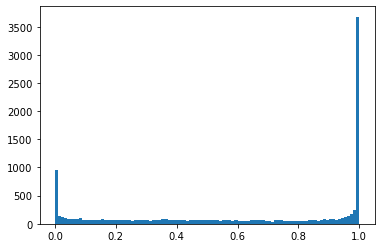

In [14]:
cloud_cover_frac = np.load('data/cloud_cover_fractions.npy')

print("Number of chips with 0% (100%) cloud cover: ", (cloud_cover_frac == 0).sum(), (cloud_cover_frac == 1).sum())
plt.hist(cloud_cover_frac, bins=100)

In [11]:
# longitude/latitude of image's center
with rasterio.open(example_chip["B04_path"]) as img:
    lon, lat = img.lnglat()
    bounds = img.bounds
print(f"Longitude: {lon}, latitude: {lat}")

bounds

Longitude: 35.46935026347422, latitude: 2.9714117132510944


BoundingBox(left=771935.0, bottom=326180.0, right=777055.0, top=331300.0)

In [12]:
import pyproj

def lat_long_bounds(filepath):
    """Given the path to a GeoTIFF, returns the image bounds in latitude and
    longitude coordinates.

    Returns points as a tuple of (left, bottom, right, top)
    """
    with rasterio.open(filepath) as im:
        bounds = im.bounds
        meta = im.meta
    # create a converter starting with the current projection
    current_crs = pyproj.CRS(meta["crs"])
    crs_transform = pyproj.Transformer.from_crs(current_crs, current_crs.geodetic_crs)

    # returns left, bottom, right, top
    return crs_transform.transform_bounds(*bounds)

left, bottom, right, top = lat_long_bounds(example_chip["B04_path"])
print(
    f"Image coordinates (lat, long):\nStart: ({left}, {bottom})"
    f"\nEnd: ({right}, {top})"
)
dlat_lon = [top-bottom, right-left]
dlat_lon

Image coordinates (lat, long):
Start: (2.948221298028172, 35.44628398518643)
End: (2.9946024439490517, 35.492417498478574)


[0.04613351329214055, 0.04638114592087961]

/tmp/ipykernel_10213/2595873416.py:30: UserWarning: No contour levels were found within the data range.
  ax[iy, ix].contour(imi_label, vmin=0, vmax=1, cmap=cmap_true)
/tmp/ipykernel_10213/2595873416.py:30: UserWarning: No contour levels were found within the data range.
  ax[iy, ix].contour(imi_label, vmin=0, vmax=1, cmap=cmap_true)


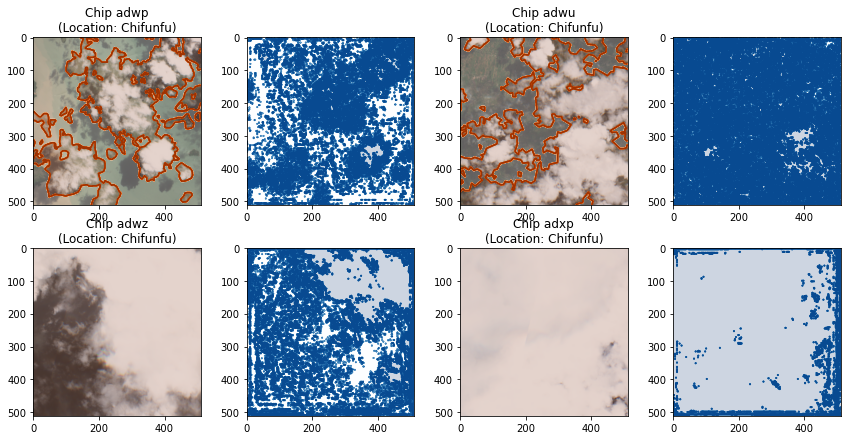

In [13]:
def display_chips(chips, nplt=None, figsize=None):
    
    if nplt is None:
        nplt = len(chips)
        
    cmap_true = plt.cm.Oranges
    cmap_pred = plt.cm.Blues
    
    nx = int(np.sqrt(nplt))
    ny = math.ceil(nplt/nx)
    if figsize is None:
        figsize=(nx*3*2, ny*3)
        
    fig, ax = plt.subplots(ny, nx*2, figsize=figsize)

    plt.subplots_adjust(hspace=0.02, wspace=0.2) 
    
    for iplt in range(nplt):
        iy = iplt // nx
        ix = (iplt % nx) * 2 
        
        chip = chips.iloc[iplt]
        
        imi = load_image(chip.chip_id) 
        imi_rgb = true_color_img(imi)
        imi_label = np.array(Image.open(chip.label_path))

        ax[iy, ix].imshow(imi_rgb)
        ax[iy, ix].imshow(imi_label, vmin=0, vmax=1, cmap=cmap_true, alpha=0.2)
        ax[iy, ix].contour(imi_label, vmin=0, vmax=1, cmap=cmap_true)

        label_predict_path = PREDICTION_DIR + chip.chip_id + '.tif'
        label_exists = os.path.exists(label_predict_path)
        
        if label_exists:
            imi_label_predict = np.array(Image.open(label_predict_path))
            ax[iy, ix+1].imshow(imi_label_predict, vmin=0, vmax=1, cmap=cmap_pred, alpha=0.2)
            ax[iy, ix+1].contour(imi_label_predict, vmin=0, vmax=1, cmap=cmap_pred)

        ax[iy, ix].set_title(f"Chip {chip.chip_id}\n(Location: {chip.location})")


    plt.tight_layout()
    plt.show()

nplt = 4
chips = train_meta.iloc[:nplt]

display_chips(chips, nplt=None)


None
[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
None
[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]


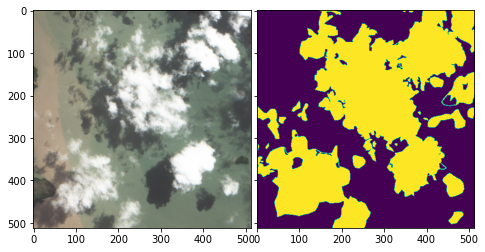

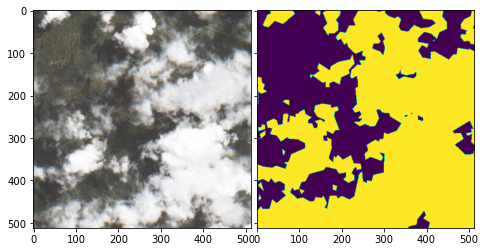

In [17]:
# def display_chip_bands(chip, bands_use=["B02", "B03", "B04", "B08"], figsize=None):

#     nx = len(bands_use)+3
#     if figsize is None:
#         figsize=(nx*3, 3)
        
#     fig, ax = plt.subplots(1, nx, figsize=figsize)

#     plt.subplots_adjust(hspace=0.02, wspace=0.02) 
    
#     images = load_image(chip.chip_id, bands=bands_use)

#     imi = true_color_img(images)
#     mask = np.array(Image.open(chip.label_path))

#     NDVI = (images["B08"] - images["B04"]) / (images["B08"] + images["B04"] )
#     NDSI = (images["B02"] - images["B08"]) / (images["B02"] + images["B08"] )

#     ax[0].imshow(imi)
#     ax[0].contour(mask, cmap=plt.cm.Reds)
#     ax[0].set_title(f"True color image for chip id {chip.chip_id}")

#     ax[1].imshow(NDSI)
#     ax[1].set_title("NDSI (B03-B11)/(B03+B11)")
#     ax[2].imshow(NDVI)
#     ax[2].set_title("NDVI (B08-B04)/(B08+B04)")

#     for i, (k, v) in enumerate(images.items()):
#         ax[i+3].imshow(v)
#         ax[i+3].set_title(k)

# bands_use = #, "B08", "B11"]



# Save chips in .npz for easier sharing

In [38]:
import math

DATA_DIR = Path.cwd().parent.resolve() / "data/"
PREDICTION_DIR = "/global/cscratch1/sd/gstein/machine_learning/cloud_cover/notebooks/unet_src/predictions/"

def load_image_to_array(chip_id, bands=["B02", "B03", "B04", "B08"],
               data_dir=TRAIN_FEATURES, data_dir_new=TRAIN_FEATURES_NEW):
    """Given the path to the directory of Sentinel-2 chip feature images,
    plots the true color image"""
    
    original_bands=["B02", "B03", "B04", "B08"]
    
    npixx = 512
    npixy = 512
    
    # chip_image = np.zeros((len(want_bands), npix[0], npix[1]), dtype=np.uint16)
    chip_image = {}

    image_array = np.zeros((len(bands), npixx, npixy), dtype=np.float32)
    for i, band in enumerate(bands):
        if band in original_bands:
            chip_dir = data_dir / chip_id
        else:
            chip_dir = data_dir_new / chip_id

        image_array[i] = np.array(get_array(chip_dir / f"{band}.tif")).astype(np.float32)
  
    return image_array


# def tif_to_numpy(random_state, nplt=1, figsize=None):
    
def get_chips_in_npy(nchips=1, bands=["B02", "B03", "B04", "B08"]):

    npixx = 512
    npixy = 512
    
    images = np.zeros((nchips, len(bands), npixx, npixy), dtype=np.uint16)
    labels = np.zeros((nchips, npixx, npixy), dtype=np.uint8)
    
    for ichip in range(nchips):

        random_chip = train_meta.iloc[ichip]
        images[ichip] = load_image_to_array(random_chip.chip_id, bands=bands)  
        labels[ichip] = np.array(Image.open(random_chip.label_path))

    return images, labels


nchips=100
images, labels = get_chips_in_npy(nchips=nchips)

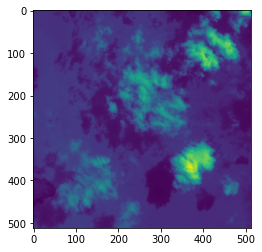

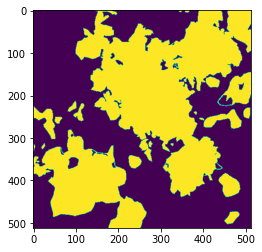

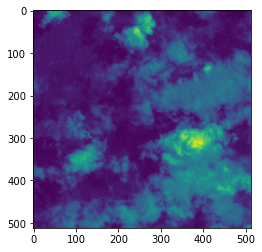

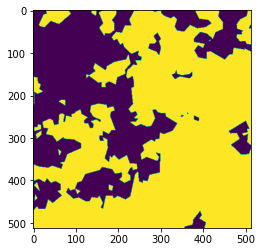

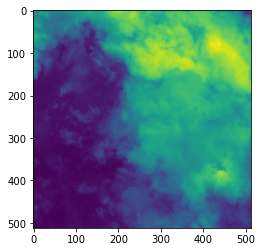

...

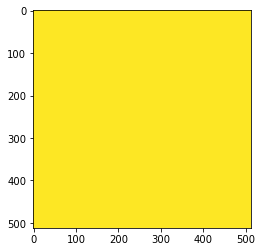

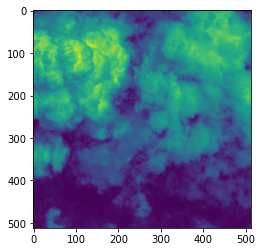

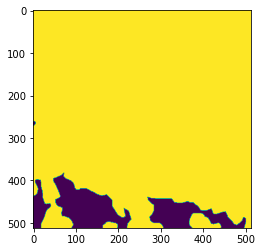

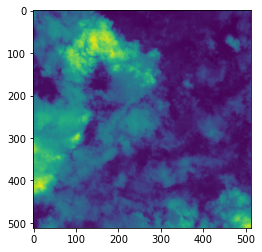

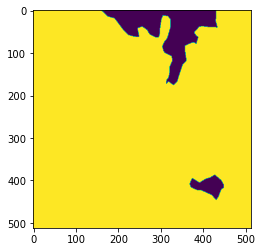

In [43]:
nplt = 10
for i in range(nplt):
    plt.figure()
    plt.imshow(images[i,1])
    plt.figure()
    plt.imshow(labels[i], vmin=0, vmax=1)

In [40]:
np.save("../../data/image_arrays/images.npy", images)
np.save("../../data/image_arrays/labels.npy", labels)


/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_27573/1903263362.py:18: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)


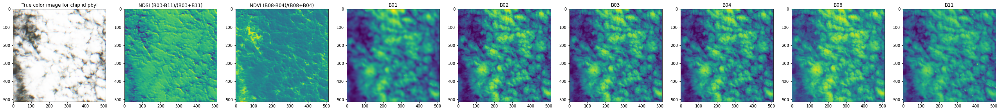

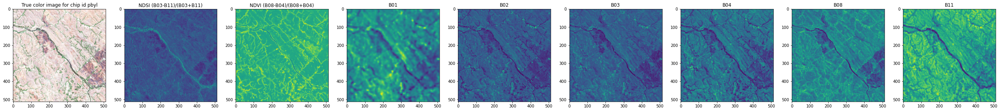

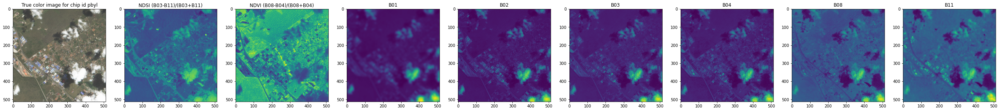

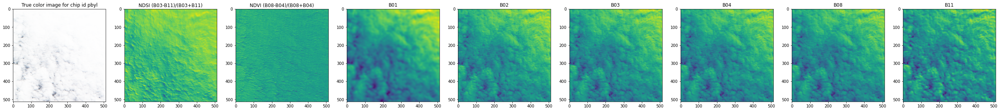

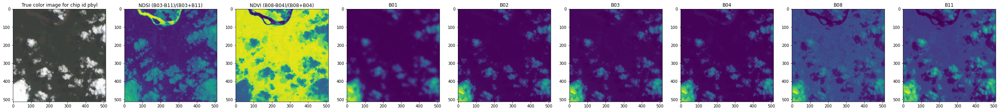

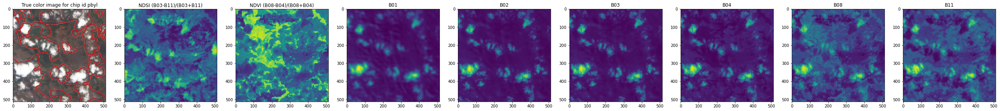

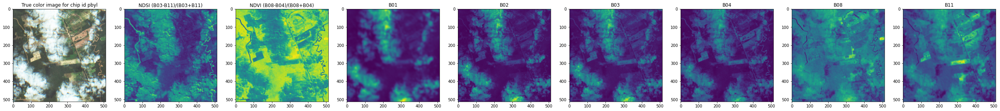

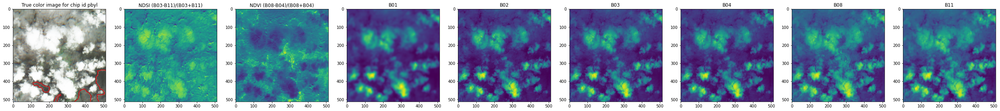

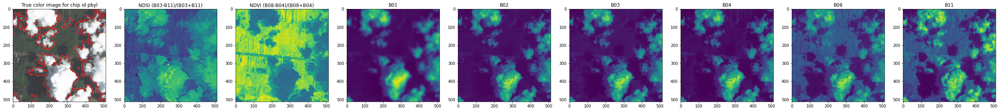

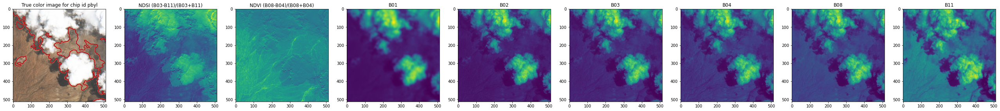

## Calculate mean and std of bands

In [33]:
df_train = pd.read_csv(DATA_DIR / "train_metadata.csv")

# use_bands = ["B01", "B02", "B03", "B04", "B08", "B11"]
use_bands = ["B02", "B03", "B04", "B08"]

# train_subset = train_meta.sample(n=2, random_state=0)
nchips = len(df_train)

measured_stats = {}
for iband, band in enumerate(use_bands):
    print(band)
    images_all = np.zeros((nchips, 512, 512), dtype=np.uint16)
    
    for irow, row in enumerate(df_train.itertuples()):
        if irow % 1000 == 0:
            print(f"loaded image {irow}") 
        imi = load_image(row.chip_id, bands=[band])
        
        images_all[irow] = imi[band]
        
    measured_stats[band] = {'mean': np.mean(images_all),
                           'std': np.std(images_all),
                           'min': np.min(images_all),
                           'max': np.max(images_all)}
                           


B02
loaded image 0
loaded image 1000
loaded image 2000
loaded image 3000
loaded image 4000
loaded image 5000
loaded image 6000
loaded image 7000
loaded image 8000
loaded image 9000
loaded image 10000
loaded image 11000
B03
loaded image 0
loaded image 1000
loaded image 2000
loaded image 3000
loaded image 4000
loaded image 5000
loaded image 6000
loaded image 7000
loaded image 8000
loaded image 9000
loaded image 10000
loaded image 11000
B04
loaded image 0
loaded image 1000
loaded image 2000
loaded image 3000
loaded image 4000
loaded image 5000
loaded image 6000
loaded image 7000
loaded image 8000
loaded image 9000
loaded image 10000
loaded image 11000
B08
loaded image 0
loaded image 1000
loaded image 2000
loaded image 3000
loaded image 4000
loaded image 5000
loaded image 6000
loaded image 7000
loaded image 8000
loaded image 9000
loaded image 10000
loaded image 11000


In [34]:
measured_stats

{'B02': {'mean': 2848.064112016446,
  'std': 3156.9268464765087,
  'min': 0,
  'max': 27600},
 'B03': {'mean': 2839.0871485290295,
  'std': 2899.280144509762,
  'min': 0,
  'max': 26096},
 'B04': {'mean': 2741.2891076425326,
  'std': 2789.961608891907,
  'min': 0,
  'max': 23104},
 'B08': {'mean': 3657.9092112857143,
  'std': 2424.18942846055,
  'min': 0,
  'max': 19568}}

In [35]:
np.save('measured_band_stats', measured_stats)

/tmp/ipykernel_27411/2215286950.py:16: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)


2.0 10006.0 2.0 10006.0 1.0 1.0 0.0
2.0 10006.0 1.0 9232.0 0.0018083183 1137.0 6.245465
2.0 10006.0 88.0 8888.0 0.0020408162 11.973077 0.53498423
2.0 10006.0 88.0 8680.0 0.004237288 10.363636 0.49731898
2.0 10006.0 275.0 9032.0 0.0009596929 7.596811 0.3284549
2.0 10006.0 465.0 8686.0 0.002570694 4.1001854 0.2927735


/tmp/ipykernel_27411/2215286950.py:16: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)


184.0 729.0 184.0 729.0 1.0 1.0 0.0
184.0 729.0 36.0 1864.0 0.22666667 7.4473686 0.29301646
184.0 729.0 113.0 2688.0 0.15370706 2.7305698 0.123975255
184.0 729.0 28.0 3640.0 0.11290322 12.071428 0.1665877
184.0 729.0 1.0 5148.0 0.059226934 300.0 0.79559463
184.0 729.0 324.0 5509.0 0.07654563 0.73410404 0.029782156


/tmp/ipykernel_27411/2215286950.py:16: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)


71.0 11327.0 71.0 11327.0 1.0 1.0 0.0
71.0 11327.0 57.0 10744.0 0.17691498 9.462026 0.3443685
71.0 11327.0 136.0 10176.0 0.17661788 6.3333335 0.28422087
71.0 11327.0 176.0 9808.0 0.16926202 5.552817 0.29647282
71.0 11327.0 355.0 9392.0 0.06966925 3.435484 0.26187178
71.0 11327.0 606.0 7395.0 0.08049887 2.2209644 0.2615545


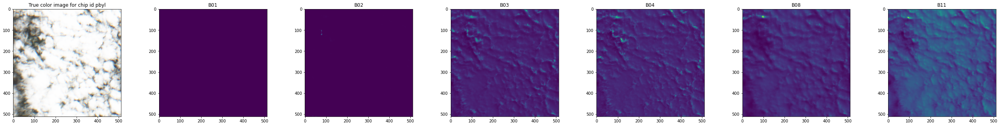

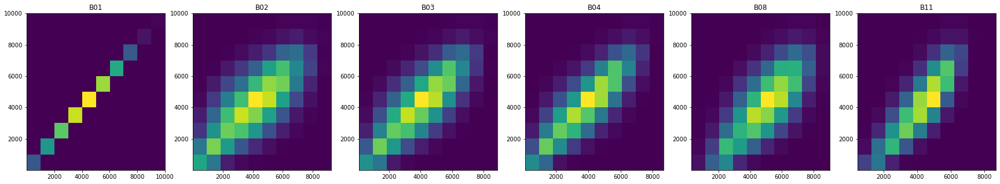

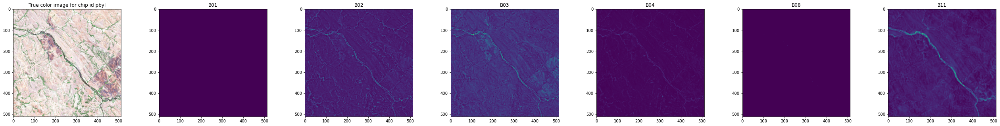

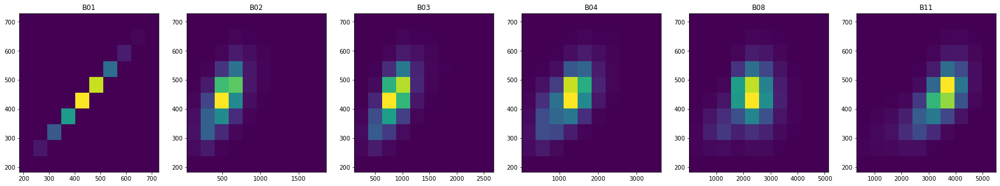

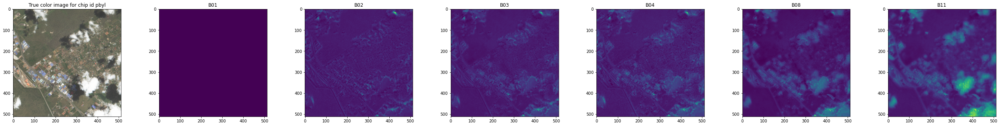

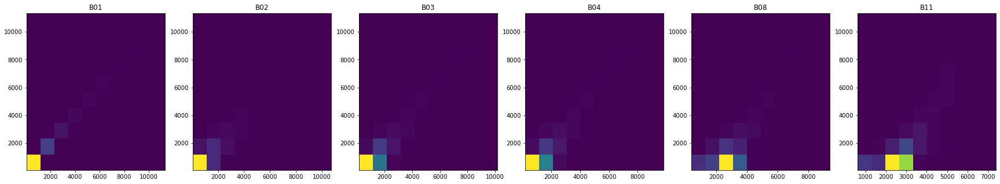

In [21]:
use_bands = ["B01", "B02", "B03", "B04", "B08", "B11"]
nx = len(use_bands)

train_subset = train_meta.sample(n=3, random_state=0)

for irow, row in enumerate(train_subset.itertuples()):

    images = load_image(row.chip_id, bands=use_bands)

    imi = true_color_img(images)
    mask = np.array(Image.open(row.label_path))
    
    fig, ax = plt.subplots(1, nx+1, figsize=(5*(nx+3), 5))

    ax[0].imshow(imi)
    ax[0].contour(mask, cmap=plt.cm.Reds)
    mask = np.array(Image.open(example_chip.label_path))

    ax[0].set_title(f"True color image for chip id {example_chip.chip_id}")

    for i, (k, v) in enumerate(images.items()):
        imi = images['B01']/v
        print(images['B01'].min(), images['B01'].max(), v.min(), v.max(), imi.min(), imi.max(), imi.std())
        ax[i+1].imshow(imi)
        ax[i+1].set_title(k)

    fig, ax = plt.subplots(1, nx, figsize=(5*(nx), 5))
    for i, (k, v) in enumerate(images.items()):
        ax[i].hist2d(v.flatten(), images['B01'].flatten())
        ax[i].set_title(k)



In [12]:
# construct some augmentations
import albumentations as A
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomRotate90(p=0.5),
    A.Transpose(p=0.5),
])

im = load_image(example_chip.chip_id)
imi = true_color_img(im)

mask = np.array(Image.open(example_chip.label_path))
print(im.shape, imi.shape, mask.shape)
print(im.dtype, imi.dtype, mask.dtype)

fig, ax = plt.subplots(figsize=(5, 5))
ax.imshow(imi)
ax.contour(mask)
plt.title(f"True color image for chip id {example_chip.chip_id}")

im = np.transpose(im, [1, 2, 0])

print('im before', im.shape)
transformed = transform(image=im, mask=mask[..., None])

print('after transform = ', transformed['image'].shape)
im_T = transformed['image']

im_T = np.transpose(transformed['image'], [2, 0, 1])
print('after transpose & transform ', im_T.shape)

imi_T = true_color_img(im_T)
mask_T = transformed['mask'][:, :, 0]
print(im_T.shape, mask_T.shape)
fig, ax = plt.subplots(figsize=(5, 5))
ax.imshow(imi_T)
ax.contour(mask_T)
plt.title(f"True color image for chip id {example_chip.chip_id}")

NameError: name 'example_chip' is not defined

In [ ]:

train_subset = train_meta.sample(n=4, random_state=0)

# define path where we'll save each new band image
# new_bands = ["data"]  
# new_band_dirs = ["LC"]  # , 

new_bands = ["B01", "B11"]
new_band_dirs = ["B01", "B11"]

for band in new_band_dirs:
    band_dir = Path(DATA_DIR / f"{band}_images")
    train_subset[f"{band}_path"] = band_dir / (train_subset["chip_id"] + ".tif")

train_subset


/tmp/ipykernel_36667/3271225156.py:29: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: No contour levels were found within the data range.
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: The following kwargs were not used by contour: 'interpolation'
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:41: UserWarning: No contour levels were found within the data range.
  ax[2].contour(mask, cmap=plt.cm.Reds)


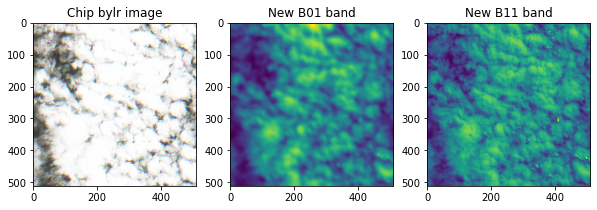

/tmp/ipykernel_36667/3271225156.py:29: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: No contour levels were found within the data range.
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: The following kwargs were not used by contour: 'interpolation'
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:41: UserWarning: No contour levels were found within the data range.
  ax[2].contour(mask, cmap=plt.cm.Reds)


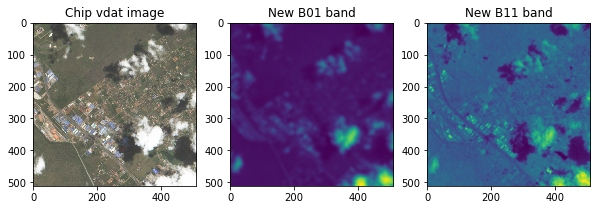

/tmp/ipykernel_36667/3271225156.py:29: UserWarning: No contour levels were found within the data range.
  ax[0].contour(mask, cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: No contour levels were found within the data range.
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:35: UserWarning: The following kwargs were not used by contour: 'interpolation'
  ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
/tmp/ipykernel_36667/3271225156.py:41: UserWarning: No contour levels were found within the data range.
  ax[2].contour(mask, cmap=plt.cm.Reds)


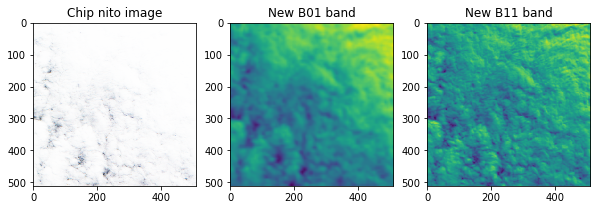

In [99]:

        
for irow, row in enumerate(train_subset.itertuples()):
     
    im = load_image(row.chip_id)
    imi = true_color_img(im)
    mask = np.array(Image.open(row.label_path))


    if os.path.isfile(row.B01_path) and os.path.isfile(row.B11_path):
        
        im = load_image(row.chip_id)
        imi = true_color_img(im)
        mask = np.array(Image.open(row.label_path))

        fig, ax = plt.subplots(1, 3, figsize=(10, 3))

        ax[0].imshow(imi, interpolation='none')
        ax[0].set_title(f"Chip {row.chip_id} image")
        ax[0].contour(mask, cmap=plt.cm.Reds)

        
        b01 = resize_image(Image.open(row.B01_path))

        ax[1].imshow(b01)
        ax[1].contour(mask, interpolation='none', cmap=plt.cm.Reds)
        ax[1].set_title("New B01 band")
        
        b11 = resize_image(Image.open(row.B11_path))

        ax[2].imshow(b11, interpolation='none')#, Image.BICUBIC))
        ax[2].contour(mask, cmap=plt.cm.Reds)
        ax[2].set_title("New B11 band")
        # ax[3].imshow(Image.open(row.LC_path))
        # ax[3].set_title("New LC")
        plt.show()

In [104]:
# create and save resized version of new images
from PIL import Image
import skimage.transform as st
import glob
import os
import sys
# small images located at Path(DATA_DIR / "new_banddata" / f"{band_dir}" / f"{row.chip_id}.tif"
# new path will be DATA_DIR/train_features_new/{row.chip_id}/{band}.tif

def resize_image(image, outsize=(512, 512), interpolation_order=1):
    """Given PIL uint16 image, return resize and interpolates image"""
    
    image = np.array(image).astype(np.float64)
    image = st.resize(image, outsize, order=interpolation_order).astype(np.uint16)
    
    return Image.fromarray(image)
        
    
is_test = 0
# if len(sys.argv) > 1:
#     is_test = int(sys.argv[1])

label_str = "train"
if is_test:
    label_str = "test"

# locations to various directories                                                                      
DATA_DIR = Path.cwd().parent.resolve() / "data/"
FEATURES_NEW = DATA_DIR / "{:s}_features_new".format(label_str)

BANDS = ["B02", "B03", "B04", "B08"]


new_bands = ["B01", "B11"]
new_band_dirs = ["B01", "B11"]

for band, band_dir in zip(new_bands, new_band_dirs):
    band_dir = Path(DATA_DIR / "new_banddata" /f"{band_dir}")
    
    print(band_dir / "*")
    files = sorted(glob.glob(str(band_dir / "*")))
    print(files)
    for fi, f_ in enumerate(files[:1]):
        out_dir = ps.path.koin(FEATURES_NEW, os.path.basename(f_))
        outdir.mkdir(exist_ok=True)

        imi = Image.open(f_)
        imi = resize_image(imi)
        
        # imi.save(band_dir / f"{row.chip_id}.tif")





/global/cscratch1/sd/gstein/machine_learning/cloud_cover/data/new_banddata/B01/*
[]
/global/cscratch1/sd/gstein/machine_learning/cloud_cover/data/new_banddata/B11/*
[]


In [18]:
chips_per_locationtime = (
    train_meta.groupby(["location", "datetime"])[["chip_id"]]
    .nunique()
    .sort_values(by="chip_id", ascending=False)
    .rename(columns={"chip_id": "chip_count"})
)
chips_per_locationtime.head(10)

,,chip_count
location,datetime,
South America - Brazil,2020-09-06 15:02:37+00:00,261
Port Gentil,2020-09-08 09:50:58+00:00,223
Uganda,2019-04-25 08:29:37+00:00,220
Australia - Central,2020-08-11 01:24:00+00:00,209
Malabo,2020-09-06 10:00:03+00:00,206
Jimma,2020-05-31 08:07:58+00:00,201
Chifunfu,2020-04-29 08:20:47+00:00,197
South America - Suriname,2020-06-03 14:11:18+00:00,197
Isiro,2020-08-28 08:39:29+00:00,197


In [18]:
def display_random_chip(random_state, nplt=1, figsize=(8, 4)):
    for iplt in range(nplt):
        
        random_chip = train_meta.sample(random_state=random_state+iplt).iloc[0]

        imi = load_image(random_chip.chip_id)
        
        imi_label = np.array(Image.open(random_chip.label_path))

        dm = imi_label == 1
        
        nchannel = imi.shape[0]
        fig, ax = plt.subplots(1, nchannel, figsize=(16,4))
        for ichannel in range(nchannel):
            bins = np.linspace(imi[ichannel].min(), imi[ichannel].max(), 25)
            ax[ichannel].hist(imi[ichannel][dm], bins=bins, color='C{:d}'.format(ichannel%10), alpha=0.8, histtype='step', facecolor=None)
            ax[ichannel].hist(imi[ichannel][~dm], bins=bins, color='C{:d}'.format(ichannel%10), alpha=0.6, histtype='step', facecolor=None, ls='--')
        
        
        imi_rgb = true_color_img(imi)
        imi_label_predict = predict_cloudcover(imi, clf)
        
        IoU = intersection_over_union(imi_label_predict, imi_label)
        print('IoU is:', IoU)
        fig, ax = plt.subplots(1, 3, figsize=figsize)
        ax[0].imshow(imi_rgb)
        ax[0].set_title(f"Chip {random_chip.chip_id}\n(Location: {random_chip.location})")
        
        ax[1].imshow(imi_label, vmin=0., vmax=1.)
        ax[1].set_title(f"Chip {random_chip.chip_id} label")

        ax[2].imshow(imi_label_predict, vmin=0., vmax=1.)
        ax[2].set_title(f"Prediction")

        plt.tight_layout()
        plt.show()

In [20]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification

# def train_cloudcover(ims):

def intersection_over_union(pred, true):
    """
    Calculates intersection and union for a batch of images.

    Args:
        pred (torch.Tensor): a tensor of predictions
        true (torc.Tensor): a tensor of labels

    Returns:
        intersection (int): total intersection of pixels
        union (int): total union of pixels
    """
    # valid_pixel_mask = true.ne(255)  # valid pixel mask
    # true = true.masked_select(valid_pixel_mask)#.to("cpu")
    # pred = pred.masked_select(valid_pixel_mask)#.to("cpu")

    # Intersection and union totals
    intersection = np.logical_and(true, pred)
    union = np.logical_or(true, pred)
    return intersection.sum() / union.sum()

def predict_cloudcover(im, clf, channel_max=[0.0, 0.0, 0.0, 2000]):
    # cloud_mask = np.zeros_like(im[0], dtype=np.int8)
    
    # dm = (im[0] > channel_max[0]) & (im[1] > channel_max[1]) & (im[2] > channel_max[2]) & (im[3] > channel_max[3])
    # dm = (im[3] > channel_max[3])
    
    # cloud_mask[dm] = 1.
    
    cloud_mask = clf.predict(np.swapaxes(im, 0, -1).reshape(-1, 4)).reshape(im.shape[-2], im.shape[-1]).T
        
    print('cloud shape =', cloud_mask.shape)
    return cloud_mask


nimg = 25
nchannel=4
npix_x = 512
npix_y = 512
images = np.zeros((nimg, nchannel, npix_x, npix_y), dtype=np.uint16) 
labels = np.zeros((nimg, npix_x, npix_y), dtype=np.uint8) 

for i in range(nimg):
    ichip = train_meta.iloc[0] 
    images[i] = load_image(ichip.chip_id)
    labels[i] = np.array(Image.open(ichip.label_path))


/tmp/ipykernel_45254/3641423883.py:24: UserWarning: No contour levels were found within the data range.
  ax[iy, ix].contour(imi_label)
/tmp/ipykernel_45254/3641423883.py:24: UserWarning: No contour levels were found within the data range.
  ax[iy, ix].contour(imi_label)
/tmp/ipykernel_45254/3641423883.py:24: UserWarning: No contour levels were found within the data range.
  ax[iy, ix].contour(imi_label)


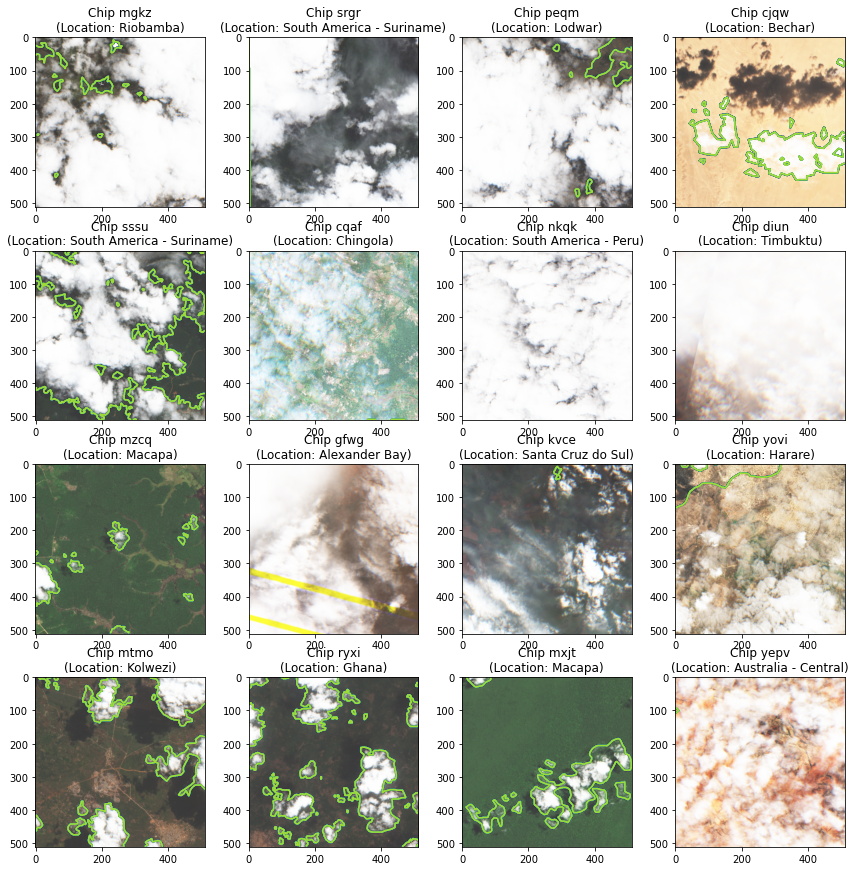

In [31]:
from pystac_client import Client
import planetary_computer as pc

catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

In [32]:
collections = catalog.get_children()
for collection in collections:
    print(f"{collection.id} - {collection.title}")

gap - USGS Gap Land Cover
nasadem - NASADEM HGT v001
daymet-annual-na - Daymet Annual North America
hrea - HREA: High Resolution Electricity Access
daymet-monthly-hi - Daymet Monthly Hawaii
daymet-daily-na - Daymet Daily North America
daymet-monthly-na - Daymet Monthly North America
daymet-annual-pr - Daymet Annual Puerto Rico
daymet-daily-pr - Daymet Daily Puerto Rico
daymet-daily-hi - Daymet Daily Hawaii
daymet-monthly-pr - Daymet Monthly Puerto Rico
aster-l1t - ASTER L1T
daymet-annual-hi - Daymet Annual Hawaii
io-lulc - Esri 10-Meter Land Cover
jrc-gsw - JRC Global Surface Water
landsat-8-c2-l2 - Landsat 8 Collection 2 Level-2
mobi - MoBI: Map of Biodiversity Importance
mtbs - MTBS: Monitoring Trends in Burn Severity
terraclimate - TerraClimate
sentinel-2-l2a - Sentinel-2 Level-2A
us-census - US Census
cop-dem-glo-30 - Copernicus DEM GLO-30
cop-dem-glo-90 - Copernicus DEM GLO-90
fia - Forest Inventory and Analysis
gbif - Global Biodiversity Information Facility (GBIF)
goes-cmi - GOE

In [33]:
# io-lulc - Esri 10-Meter Land Cover
collection = "io-lulc"
land_cover = catalog.get_child(collection)

# "summaries":{"raster:bands":[{"nodata":0,"spatial_resolution":10}],"label:classes":[{"name":"","classes":["nodata","water","trees","grass","flooded veg","crops","scrub","built area","bare","snow/ice","clouds"]}]
for property, value in vars(land_cover.summaries).items():
    print(property, ":", value)
    
landcover_classes = land_cover.summaries._summaries['label:classes'][0]['classes']
landcover_classes

# for band in land_cover.extra_fields["summaries"]["eo:bands"]:
#     name = band["name"]
#     description = band["description"]
#     common_name = "" if "common_name" not in band else f"({band['common_name']})"
#     ground_sample_distance = band["gsd"]
#     print(f"{name} {common_name}: {description} ({ground_sample_distance}m resolution)")


_summaries : {'raster:bands': [{'nodata': 0, 'spatial_resolution': 10}], 'label:classes': [{'name': '', 'classes': ['nodata', 'water', 'trees', 'grass', 'flooded veg', 'crops', 'scrub', 'built area', 'bare', 'snow/ice', 'clouds']}]}
maxcount : 25
lists : {'raster:bands': [{'nodata': 0, 'spatial_resolution': 10}], 'label:classes': [{'name': '', 'classes': ['nodata', 'water', 'trees', 'grass', 'flooded veg', 'crops', 'scrub', 'built area', 'bare', 'snow/ice', 'clouds']}]}
ranges : {}
schemas : {}
other : {}


['nodata',
 'water',
 'trees',
 'grass',
 'flooded veg',
 'crops',
 'scrub',
 'built area',
 'bare',
 'snow/ice',
 'clouds']

/tmp/ipykernel_54155/1782024454.py:169: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("tab10").copy()
  cmap.set_bad(color='white')
/tmp/ipykernel_54155/1782024454.py:187: UserWarning: No contour levels were found within the data range.
  ax[0].contour(imi_label)
/tmp/ipykernel_54155/1782024454.py:200: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.set_ticklabels(landcover_classes[1:])
/tmp/ipykernel_54155/1782024454.py:200: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.set_ticklabels(landcover_classes[1:])
/tmp/ipykernel_54155/1782024454.py:191: UserWarning: No contour levels were found within the data range.
  ax[1].contour(landcoveri, levels=np.arange(len(landcover_class

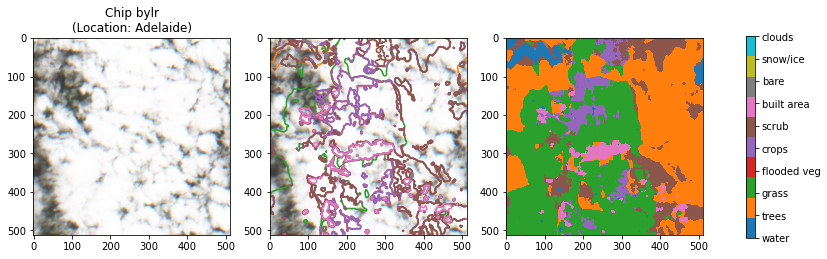

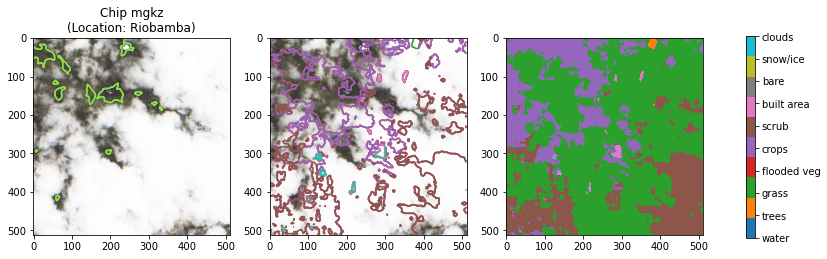

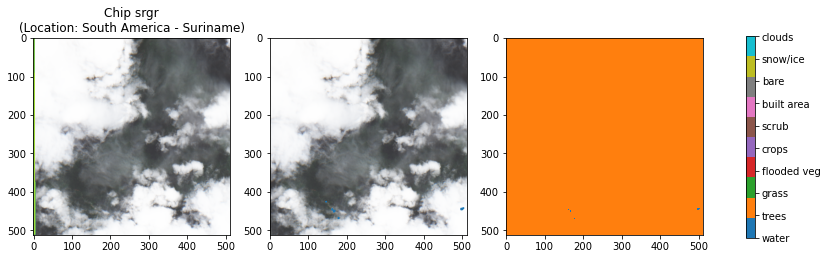

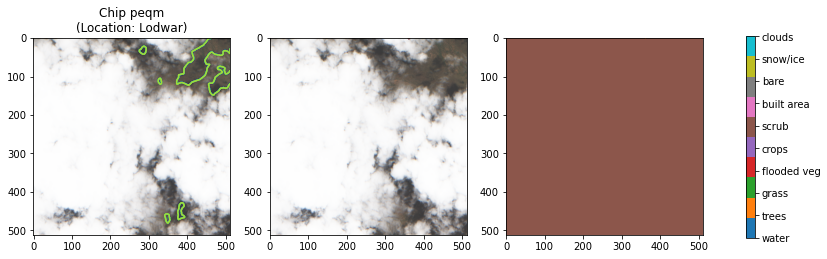

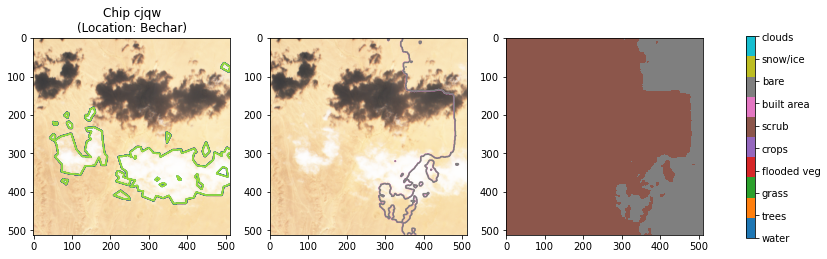

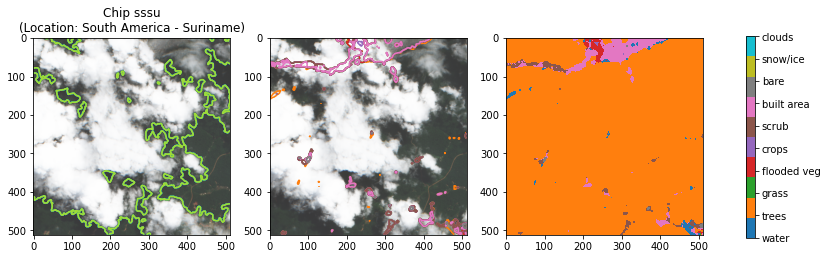

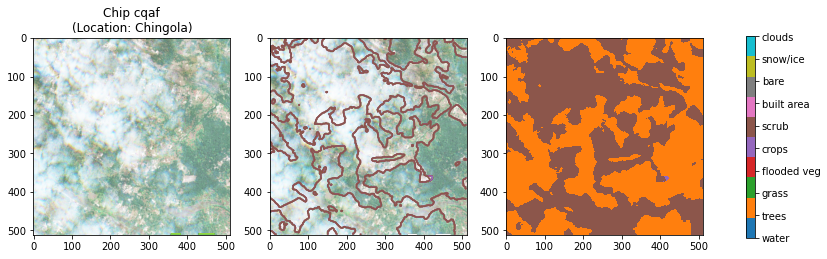

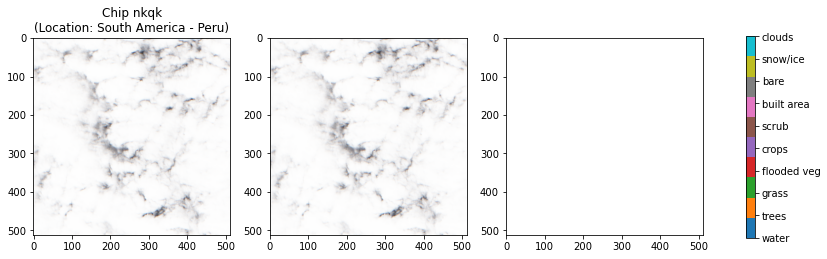

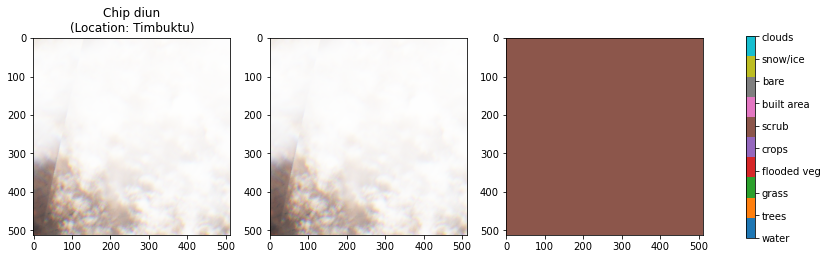

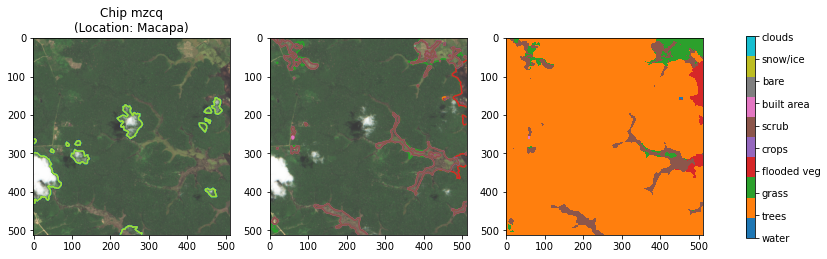

In [36]:
# https://planetarycomputer.microsoft.com/docs/tutorials/landcover/
import rasterio
from rasterio import windows
from rasterio import features
from rasterio import warp

import numpy as np
from PIL import Image

import stac_vrt
import rioxarray

import scipy.ndimage

def lat_long_bounds(filepath):
    """Given the path to a GeoTIFF, returns the image bounds in latitude and
    longitude coordinates.

    Returns points as a tuple of (left, bottom, right, top)
    """
    with rasterio.open(filepath) as im:
        bounds = im.bounds
        meta = im.meta
        
    # create a converter starting with the current projection
    current_crs = pyproj.CRS(meta["crs"])
    crs_transform = pyproj.Transformer.from_crs(current_crs, current_crs.geodetic_crs)

    # returns left, bottom, right, top
    return crs_transform.transform_bounds(*bounds)

def lat_lon_bounds_2(filepath: os.PathLike):
    """Given the path to a GeoTIFF, returns the image bounds in latitude and
    longitude coordinates.

    Returns points as a tuple of (left, bottom, right, top)
    
    from https://github.com/microsoft/PlanetaryComputerExamples/blob/main/competitions/cloud-cover/additional-bands-tutorial.ipynb
    """
    with rasterio.open(filepath) as im:
        bounds = im.bounds
        meta = im.meta
    # create a converter starting with the current projection
    return rasterio.warp.transform_bounds(
        meta["crs"],
        4326,  # code for the lat-lon coordinate system
        *bounds,
    )

def get_area_of_interest(chip):

    left, bottom, right, top = lat_long_bounds(chip["B04_path"])

    area_of_interest = {
        "type": "Polygon",
        "coordinates": [
            [
                [bottom, left],
                [bottom, right],
                [top, right],
                [top, left],
                [bottom, left],
            ]
        ],
    }

    return area_of_interest


def rebin(a, newshape ):
        '''Rebin an array to a new shape.
        '''
        assert len(a.shape) == len(newshape)

        slices = [ slice(0, old, float(old)/new) for old,new in zip(a.shape,newshape) ]
        coordinates = np.mgrid[slices]
        indices = coordinates.astype('i')   #choose the biggest smaller integer index
        
        return a[tuple(indices)]
    
def get_landcover(chip, time_of_interest, return_all=False):
    
    min_landcover_pix = 500
    rebin_xy = np.array([512, 512])
    
    area_of_interest = get_area_of_interest(chip)   

    search = catalog.search(
            collections=["io-lulc"],
            intersects=area_of_interest,
            datetime=time_of_interest)

    items = list(search.get_items())
                  
    items = sorted(items, key=lambda item: item.datetime.date()) # sort by latest last

    # Loop over all items, to find one with least missing values
    landcover_data = []
    masked_frac = []
    for itemi in items:
        asset_href = itemi.assets["data"].href
        signed_href = pc.sign(asset_href)

        # load landcover_datai
        with rasterio.open(signed_href) as ds:
            aoi_bounds = features.bounds(area_of_interest)
            warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
            aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
            landcover_datai = ds.read(window=aoi_window)[0]     
            
        if (landcover_datai.shape[-2] < min_landcover_pix) or (landcover_datai.shape[-1] < min_landcover_pix):
            # if most data is missing then skip this one
            continue
            
        landcover_datai = rebin(landcover_datai, rebin_xy) # rebin to size of sentinel images, assuming aoi_window got the proper image extent..

        landcover_data.append(landcover_datai)
        masked_frac.append(len(landcover_datai[landcover_datai==0])/landcover_datai.flatten().shape[0])

        # print('aoi_bounds', aoi_bounds)
        # print('warped_aoi_bounds', warped_aoi_bounds)
        # print('aoi_window', aoi_window)
        # print(band_datai.shape)
        
    # return "best" landcover map, or attempt to make one
    if not return_all:
        if len(landcover_data) > 0:
            # return best landcover map, or construct one:
            ind_min = masked_frac.index(min(masked_frac))        
            # if masked_frac[ind_min] == 0.: # assume first map with no zeros is "best"
            landcover_data = landcover_data[ind_min]
        else:
            landcover_data = np.zeros((512, 512), dtype=np.uint8)
     
    return landcover_data


# nplt = 1

# time_of_interest = "2000-01-01/2022-01-01"

# cmap = plt.cm.tab10  # Can be any colormap that you want after the cm
# cmap.set_bad(color='white')

# for iplt in range(nplt):

#     chip = train_meta.sample(random_state=iplt).iloc[0] # chip to use

#     # get all land cover predictions for this tile
#     landcover = get_landcover(chip, time_of_interest)  
    
#     imi = load_image(chip.chip_id) 
#     imi_label = np.array(Image.open(chip.label_path))
#     imi_rgb = true_color_img(imi)

#     # plot
#     nx = len(landcover)+3
#     fig, ax = plt.subplots(1, nx, figsize=(nx*4, 4))
    
#     ax[0].imshow(imi_rgb)
#     ax[0].contour(imi_label)
#     ax[0].set_title(f"Chip {chip.chip_id}\n(Location: {chip.location})")

#     ax[1].imshow(imi_rgb)
#     ax[1].contour(landcover[0], levels=np.arange(len(landcover_classes)), cmap=cmap)

#     for i, lc in enumerate(landcover):
#         print('number of zeros', lc.min(), len(lc[lc==0])/lc.flatten().shape[0])

#         lc_masked = np.ma.masked_where(lc == 0., lc)

#         im = ax[i+2].imshow(lc_masked, vmin=1, vmax=10, cmap=cmap, interpolation='none')

#     diff = np.zeros_like(landcover[0])
#     diff[landcover[0] != landcover[-1]] = 1
#     ax[-1].imshow(diff, vmin=0, vmax=1, interpolation='none')

#     cbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])
#     cbar = fig.colorbar(im, cax=cbar_ax)
#     cbar.set_ticklabels(landcover_classes[1:])

#     # plt.colorbar(cb)
    
    
nplt = 10
collection = "io-lulc"

time_of_interest = "2000-01-01/2022-01-01"

cmap = plt.cm.tab10  # Can be any colormap that you want after the cm
cmap.set_bad(color='white')

for iplt in range(nplt):

    chip = train_meta.sample(random_state=iplt).iloc[0] # chip to use

    # get all land cover predictions for this tile
    landcoveri = get_landcover(chip, time_of_interest)  
    
    imi = load_image(chip.chip_id) 
    imi_label = np.array(Image.open(chip.label_path))
    imi_rgb = true_color_img(imi)

    # plot
    nx = 3
    fig, ax = plt.subplots(1, nx, figsize=(nx*4, 4))
    
    ax[0].imshow(imi_rgb)
    ax[0].contour(imi_label)
    ax[0].set_title(f"Chip {chip.chip_id}\n(Location: {chip.location})")

    ax[1].imshow(imi_rgb)
    ax[1].contour(landcoveri, levels=np.arange(len(landcover_classes)), cmap=cmap)

   
    landcover_masked = np.ma.masked_where(landcoveri == 0., landcoveri)

    im = ax[2].imshow(landcover_masked, vmin=1, vmax=10, cmap=cmap, interpolation='none')

    cbar_ax = fig.add_axes([0.95, 0.15, 0.01, 0.7])
    cbar = fig.colorbar(im, cax=cbar_ax)
    cbar.set_ticklabels(landcover_classes[1:])

    # plt.colorbar(cb)

/tmp/ipykernel_54155/3013458815.py:20: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("tab10").copy()
  cmap.set_bad(color='white')


10


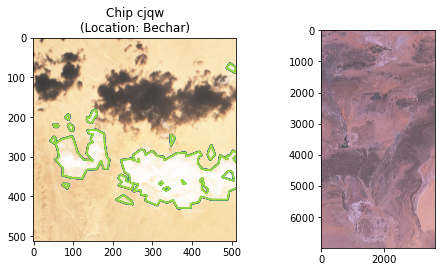

In [48]:
#Try getting band data, rather than landcover
from pystac_client import Client
from pystac.extensions.eo import EOExtension as eo
import planetary_computer as pc
import numpy as np
import xarray as xr

import rasterio.features
import stackstac
import pystac_client
import planetary_computer

import xrspatial.multispectral as ms

catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")

time_of_interest = "2000-01-01/2022-01-01"

cmap = plt.cm.tab10  # Can be any colormap that you want after the cm
cmap.set_bad(color='white')

nplt = 1
for iplt in range(4,5):

    chip = train_meta.sample(random_state=iplt).iloc[0] # chip to use

    area_of_interest = get_area_of_interest(chip)   
    bbox = rasterio.features.bounds(area_of_interest)

    search = catalog.search(
        collections=["sentinel-2-l2a"],
        # intersects=area_of_interest,
        bbox=bbox,
        datetime=time_of_interest,
        limit=10,  # fetch items in batches of 500

        query={"eo:cloud_cover": {"lt": 10}},
    )

    items = list(search.get_items())[:10]
    print(len(items))
    signed_items = [planetary_computer.sign(item).to_dict() for item in items]

    data = (
    stackstac.stack(
        signed_items,
        assets=["B04", "B03", "B02"],  # red, green, blue
        chunksize=4096,
        resolution=30,
    )
    .where(lambda x: x > 0, other=np.nan)  # sentinel-2 uses 0 as nodata
    .assign_coords(band=lambda x: x.common_name.rename("band"))  # use common names
    )
    
    median = data.median(dim="time").compute()

    # Check how many items were returned
#     items = list(search.get_items())
#     print(f"Returned {len(items)} Items")

#     least_cloudy_item = sorted(items, key=lambda item: eo.ext(item).cloud_cover)[0]

#     print(
#         f"Choosing {least_cloudy_item.id} from {least_cloudy_item.datetime.date()}"
#         f" with {eo.ext(least_cloudy_item).cloud_cover}% cloud cover"
#     )

#     asset_href = least_cloudy_item.assets["visual"].href
#     signed_href = pc.sign(asset_href)

#     with rasterio.open(signed_href) as ds:
#         aoi_bounds = features.bounds(area_of_interest)
#         warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
#         aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
#         band_data = ds.read(window=aoi_window)
        
        
    imi = load_image(chip.chip_id) 
    imi_label = np.array(Image.open(chip.label_path))
    imi_rgb = true_color_img(imi)

    # plot
    nx = 2
    fig, ax = plt.subplots(1, nx, figsize=(nx*4, 4))
    
    ax[0].imshow(imi_rgb)
    ax[0].contour(imi_label)
    ax[0].set_title(f"Chip {chip.chip_id}\n(Location: {chip.location})")

    img = ms.true_color(*median)  # expects red, green, blue DataArrays
    ax[1].imshow(img)

In [51]:
median.shape
# load landcover_datai
with median as ds:
    aoi_bounds = features.bounds(area_of_interest)
    warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
    aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
    landcover_datai = ds.read(window=aoi_window)[0]     


AttributeError: 'DataArray' object has no attribute 'crs'

In [286]:
nimg = 1000
nchannel = 4
npix_x = 512
npix_y = 512
images = np.zeros((nimg, nchannel, npix_x, npix_y), dtype=np.uint16) 
labels = np.zeros((nimg, npix_x, npix_y), dtype=np.uint8) 
landcover = np.zeros((nimg, npix_x, npix_y), dtype=np.uint8) 

for i in range(nimg):
    if i%10==0:
        print(i)
    chip = train_meta.sample(random_state=150+i).iloc[0] # chip to use
    images[i] = load_image(chip.chip_id)
    labels[i] = np.array(Image.open(chip.label_path))
    landcover[i] = get_landcover(chip, time_of_interest)  

np.savez('../data/test_images_compiled.npz',
         images=images,
         labels=labels,
         landcover=landcover,
         landcover_classes=landcover_classes)

0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890
900
910
920
930
940
950
960
970
980
990


In [279]:
landcover_classes
landcoveri.dtype
# images[0,:,-1,-1]

array([3746, 2890, 2788, 2514], dtype=uint16)

number of zeros 1 0.0
number of zeros 0 0.2638664245605469


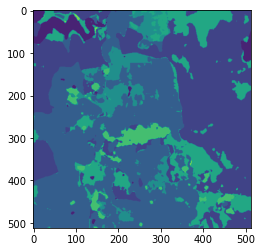

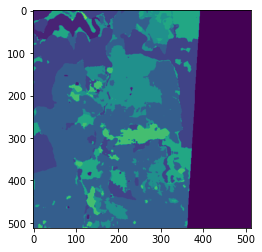

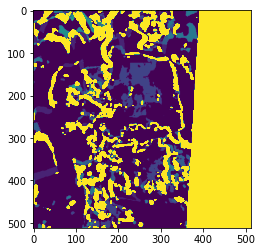

In [193]:
import scipy.interpolate as interp

def rebin(a, newshape ):
        '''Rebin an array to a new shape.
        '''
        assert len(a.shape) == len(newshape)

        slices = [ slice(0, old, float(old)/new) for old,new in zip(a.shape,newshape) ]
        coordinates = np.mgrid[slices]
        indices = coordinates.astype('i')   #choose the biggest smaller integer index
        return a[tuple(indices)]
    
rebin_xy = np.array([512, 512])

lcs = []
for i in range(len(landcover)):
    lc = rebin(landcover[i], rebin_xy)
    lcs.append(lc)
    print('number of zeros', lc.min(), len(lc[lc==0])/lc.flatten().shape[0])

    plt.figure()
    plt.imshow(lc, vmin=0, vmax=10)
    
plt.figure()
plt.imshow(lcs[1] - lcs[0], vmin=0, vmax=10)
        

Image coordinates (lat, long):
Start: (-1.385455738278118, -78.83376570205975)
End: (-1.3391257278605753, -78.78773265090366)
Returned 2 Items
Choosing 17M-2020 from 2020-06-01
(512, 512)


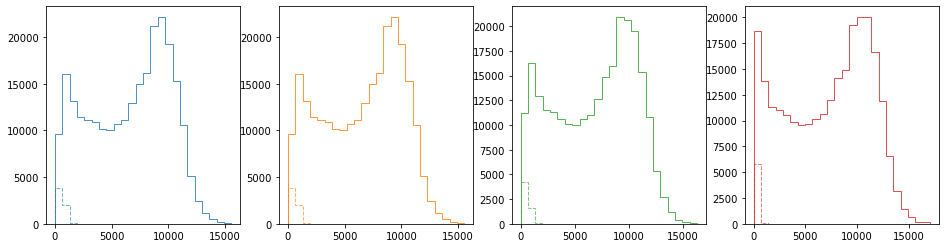

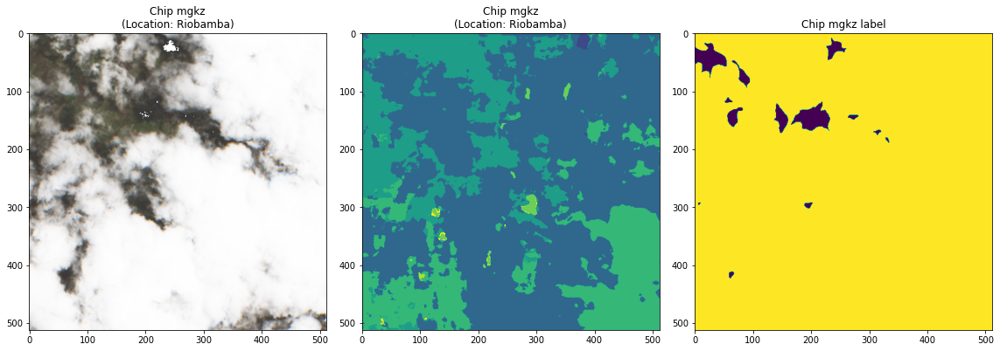

Image coordinates (lat, long):
Start: (4.523477590772273, -54.26900613315181)
End: (4.569919483842026, -54.22272755672494)
Returned 2 Items
Choosing 21N-2020 from 2020-06-01
(515, 515)


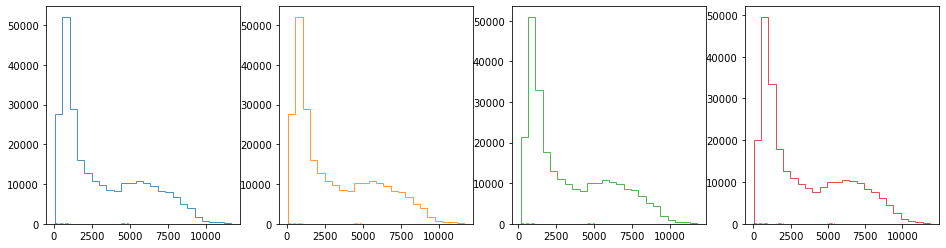

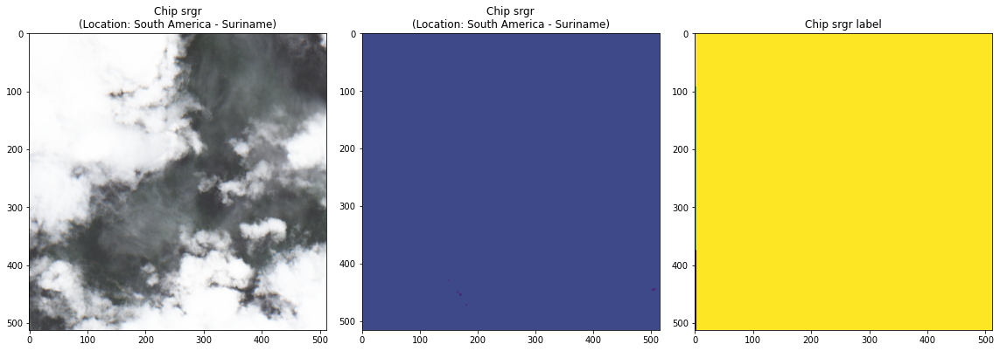

Image coordinates (lat, long):
Start: (3.506338716860272, 34.98374800413306)
End: (3.5527304566338267, 35.029917930660524)
Returned 2 Items
Choosing 36N-2020 from 2020-06-01
(514, 514)


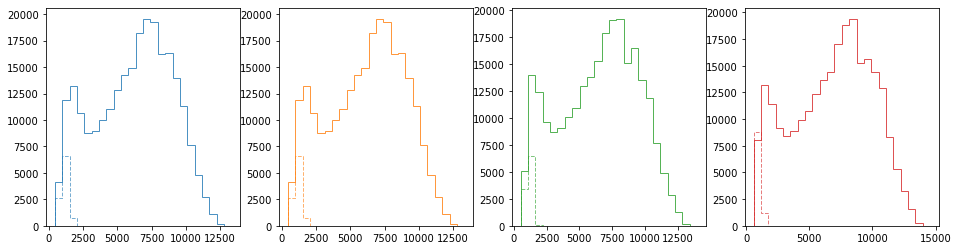

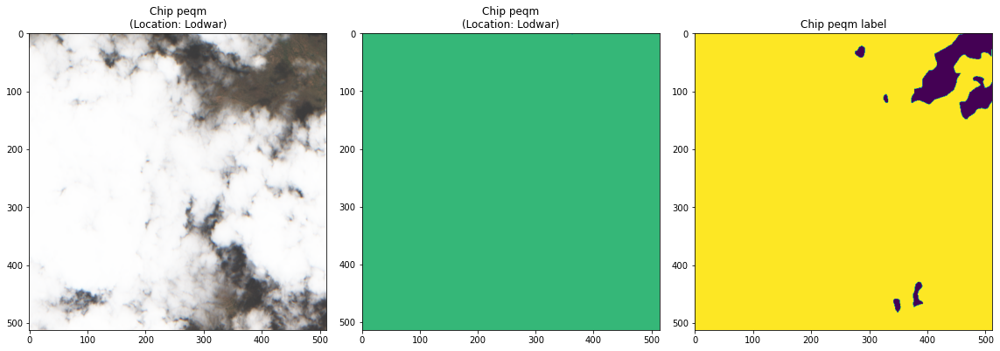

In [111]:
def display_random_chip_landcover(random_state, nplt=1, figsize=(8, 4)):
    for iplt in range(nplt):
        
        ichip = train_meta.sample(random_state=random_state+iplt).iloc[0]

        area_of_interest = get_area_of_interest(ichip)
       
        time_of_interest = "2000-01-01/2022-01-01"

        imi_landcover = get_landcover(area_of_interest, time_of_interest)             
        print(imi_landcover.shape)
        imi = load_image(ichip.chip_id)
        
        imi_label = np.array(Image.open(ichip.label_path))

        dm = imi_label == 1
        
        nchannel = imi.shape[0]
        fig, ax = plt.subplots(1, nchannel, figsize=(16,4))
        for ichannel in range(nchannel):
            bins = np.linspace(imi[ichannel].min(), imi[ichannel].max(), 25)
            ax[ichannel].hist(imi[ichannel][dm], bins=bins, color='C{:d}'.format(ichannel%10), alpha=0.8, histtype='step', facecolor=None)
            ax[ichannel].hist(imi[ichannel][~dm], bins=bins, color='C{:d}'.format(ichannel%10), alpha=0.6, histtype='step', facecolor=None, ls='--')
        
        
        imi_rgb = true_color_img(imi)

        fig, ax = plt.subplots(1, 3, figsize=figsize)
        ax[0].imshow(imi_rgb)
        ax[0].set_title(f"Chip {ichip.chip_id}\n(Location: {ichip.location})")
         
        ax[1].imshow(imi_landcover, vmin=0, vmax=9)
        ax[1].set_title(f"Chip {ichip.chip_id}\n(Location: {ichip.location})")
               
        ax[2].imshow(imi_label, vmin=0., vmax=1.)
        ax[2].set_title(f"Chip {ichip.chip_id} label")

        plt.tight_layout()
        plt.show()
        
display_random_chip_landcover(1, nplt=3, figsize=(16, 8))
        

In [81]:
items
items[0].assets

{'data': <Asset href=https://ai4edataeuwest.blob.core.windows.net/io-lulc/io-lulc-model-001-v01-composite-v03-supercell-v02-clip-v01/06V_20200101-20210101.tif>,
 'tilejson': <Asset href=https://planetarycomputer.microsoft.com/api/data/v1/item/tilejson.json?collection=io-lulc&items=06V-2020&assets=data&colormap_name=io-lulc>,
 'rendered_preview': <Asset href=https://planetarycomputer.microsoft.com/api/data/v1/item/preview.png?collection=io-lulc&items=06V-2020&assets=data&colormap_name=io-lulc>}

In [83]:
import rasterio
from rasterio import windows
from rasterio import features
from rasterio import warp

import numpy as np
from PIL import Image

with rasterio.open(signed_href) as ds:
    aoi_bounds = features.bounds(area_of_interest)
    warped_aoi_bounds = warp.transform_bounds("epsg:4326", ds.crs, *aoi_bounds)
    aoi_window = windows.from_bounds(transform=ds.transform, *warped_aoi_bounds)
    band_data = ds.read(window=aoi_window)

In [84]:
band_data.shape

(1, 4357, 6134)

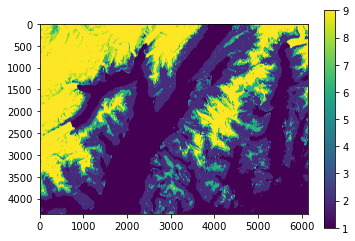

In [88]:
img = Image.fromarray(band_data[0])

plt.imshow(img)
plt.colorbar()